# 1. Facebook network

### 1. Structural properties of the facebook network

Having created the facebook network, we will study some of the structural properties of the network. To be specific, we will study  
• Connectivity  
• Degree distribution

In [139]:
if (!require("igraph")) install.packages("igraph")
library ("igraph")

In [140]:
fb_graph = read.graph("facebook_combined.txt", format="edgelist", directed=FALSE)

### Question 1

Is the facebook network connected? If not, find the giant connected component (GCC) of the network and report the size of the GCC.

In [141]:
cat("The graph has", vcount(fb_graph), "nodes\n", sep=" ")
cat("The graph has", ecount(fb_graph), "edges\n", sep=" ")

if(is.connected(fb_graph)) {
    print("The facebook network is connected")
} else {
    print("The facebook network is NOT connected")
    fb_graph.components = cluster(fb_graph)
    cat("Number of components:", fb_graph.components$csize)
    
    # which is the largest component
    ix = which.max(fb_graph.components$csize)
    # get the subgraph correspondent to just the giant component
    gcc = induced.subgraph(fb_graph, which(fb_graph.components$membership == ix))
}

The graph has 4039 nodes
The graph has 88234 edges
[1] "The facebook network is connected"


### Question 2

Find the diameter of the network. If the network is not connected, then find the diameter of the GCC.

In [142]:
if(is.connected(fb_graph)) {
    cat("The diameter of the graph is:", diameter(fb_graph), sep=" ")
} else {
    cat("The diameter of the GCC is:", diameter(gcc), sep=" ")
}

The diameter of the graph is: 8

### Question 3

Plot the degree distribution of the facebook network and report the average degree.

Mean is: 43.69101 
Variance is: 2747.92 


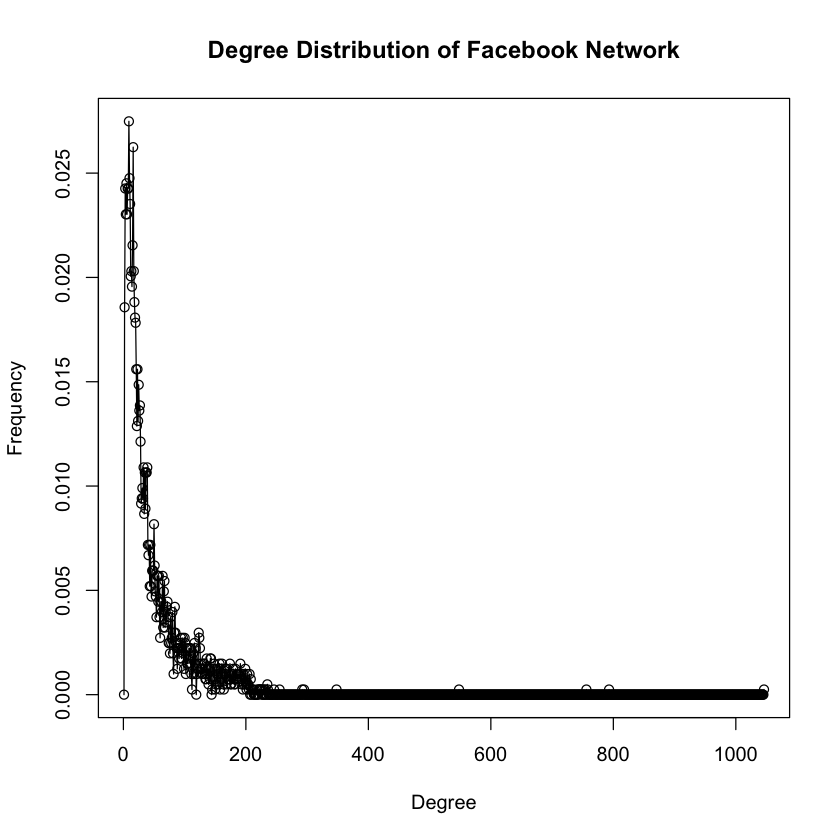

In [143]:
# show the degree distribution of fb network and report mean and variance
plot(degree_distribution(fb_graph), main = 'Degree Distribution of Facebook Network', 
     xlab = 'Degree', ylab = 'Frequency')
lines(degree_distribution(fb_graph))
cat("Mean is:", mean(degree(fb_graph)),"\n", sep=" ")
cat("Variance is:", var(degree(fb_graph)),"\n", sep=" ")

### Question 4

Plot the degree distribution of Question 3 in a log-log scale. Try to fit a line to the plot and estimate the slope of the line.

Warning message in xy.coords(x, y, xlabel, ylabel, log):
“819 y values <= 0 omitted from logarithmic plot”

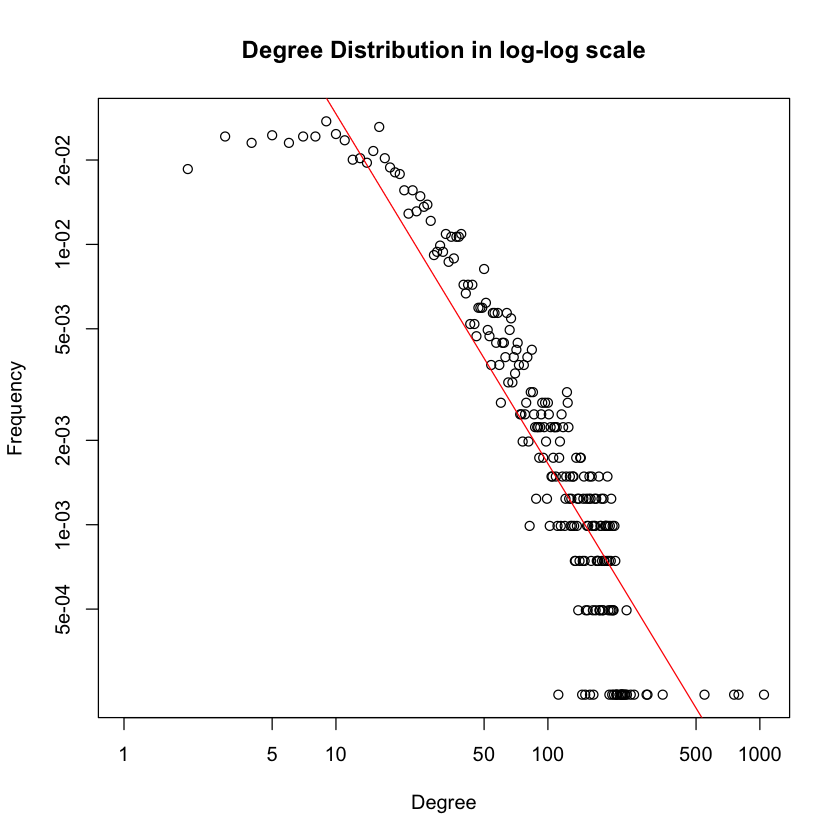

In [144]:
plot(degree_distribution(fb_graph), log = "yx",
     main = "Degree Distribution in log-log scale", xlab = "Degree", ylab = "Frequency")
line = lm(log10(degree_distribution(fb_graph)) ~ log10(1:length(degree_distribution(fb_graph))),
          subset = degree_distribution(fb_graph) > 0)
abline(line, col = "red")

In [145]:
cat("The slope of the fitted line is:", coef(line)[2])

The slope of the fitted line is: -1.247526

### 2. Personalized network

A personalized network of an user $v_i$ is defined as the subgraph induced by $v_i$ and it’s neighbors. In this part, we will study some of the structural properties of the personalized network of the user whose graph node ID is 1 (node ID in edgelist is 0). From this point onwards, whenever we are refering to a node ID we mean the graph node ID which is 1 + node ID in edgelist.

### Question 5

Create a personalized network of the user whose ID is 1. How many nodes and edges does this personalized network have?

In [146]:
node1_subg = induced.subgraph(fb_graph, c(1, neighbors(fb_graph, 1)))
cat("The personalized network of node 1 has", vcount(node1_subg), "nodes\n", sep=" ")
cat("The personalized network of node 1 has", ecount(node1_subg), "edges\n", sep=" ")

The personalized network of node 1 has 348 nodes
The personalized network of node 1 has 2866 edges


### Question 6

What is the diameter of the personalized network? Please state a trivial upper
and lower bound for the diameter of the personalized network.

In [147]:
cat("The diameter of personalized network of node 1 is", diameter(node1_subg), "\n", sep=" ")

The diameter of personalized network of node 1 is 2 


### Question 7

In the context of the personalized network, what is the meaning of the diameter of the personalized network to be equal to the upper bound you derived in Question 6? What is the meaning of the diameter of the personalized network to be equal to the lower bound you derived in Question 6 (assuming there are more than 3 nodes in the personalized network)?

### 3. Core node's personalized network

A core node is defined as the nodes that have more than 200 neighbors. For visualization purpose, we have displayed the personalized network of a core node below. ![image](pn_example.png)In this part, we will study various properties of the personalized network of the core nodes.

### Question 8

How many core nodes are there in the Facebook network. What is the average degree of the core nodes?

In [148]:
count = 0
dsum = 0
for(d in degree(fb_graph)) {
    if(d > 200) {
        count = count + 1
        dsum = dsum + d
    }
}
cat("There are", count, "core nodes\n", sep=" ")
cat("The average degree of the core nodes is", dsum / count, "\n", sep=" ")

There are 40 core nodes
The average degree of the core nodes is 279.375 


### 3.1. Community structure of core node’s personalized network

In this part, we study the community structure of the core node’s personalized network. To be specific, we will study the community structure of the personalized network of the following core nodes:  
• Node ID 1  
• Node ID 108  
• Node ID 349  
• Node ID 484  
• Node ID 1087

### Question 9

For each of the above core node’s personalized network, find the community struc- ture using Fast-Greedy, Edge-Betweenness, and Infomap community detection algorithms. Compare the modularity scores of the algorithms. For visualization purpose, display the community structure of the core node’s personalized networks using colors. Nodes belonging to the same community should have the same color and nodes belonging to different communities should have different color. In this question, you should have 15 plots in total.

In [149]:
node1_subg = induced.subgraph(fb_graph, c(1, neighbors(fb_graph, 1)))
node108_subg = induced.subgraph(fb_graph, c(108, neighbors(fb_graph, 108)))
node349_subg = induced.subgraph(fb_graph, c(349, neighbors(fb_graph, 349)))
node484_subg = induced.subgraph(fb_graph, c(484, neighbors(fb_graph, 484)))
node1087_subg = induced.subgraph(fb_graph, c(1087, neighbors(fb_graph, 1087)))

cat("The personalized network of node 1 has", vcount(node1_subg), "nodes\n", sep=" ")
cat("The personalized network of node 1 has", ecount(node1_subg), "edges\n\n", sep=" ")
cat("The personalized network of node 108 has", vcount(node108_subg), "nodes\n", sep=" ")
cat("The personalized network of node 108 has", ecount(node108_subg), "edges\n\n", sep=" ")
cat("The personalized network of node 349 has", vcount(node349_subg), "nodes\n", sep=" ")
cat("The personalized network of node 349 has", ecount(node349_subg), "edges\n\n", sep=" ")
cat("The personalized network of node 484 has", vcount(node484_subg), "nodes\n", sep=" ")
cat("The personalized network of node 484 has", ecount(node484_subg), "edges\n\n", sep=" ")
cat("The personalized network of node 1087 has", vcount(node1087_subg), "nodes\n", sep=" ")
cat("The personalized network of node 1087 has", ecount(node1087_subg), "edges\n", sep=" ")

The personalized network of node 1 has 348 nodes
The personalized network of node 1 has 2866 edges

The personalized network of node 108 has 1046 nodes
The personalized network of node 108 has 27795 edges

The personalized network of node 349 has 230 nodes
The personalized network of node 349 has 3441 edges

The personalized network of node 484 has 232 nodes
The personalized network of node 484 has 4525 edges

The personalized network of node 1087 has 206 nodes
The personalized network of node 1087 has 7409 edges


#### Node 1

Modularity score of fast greedy for node 1: 0.4131014 
[1] "Community Structure using Fast-Greedy for node 1"


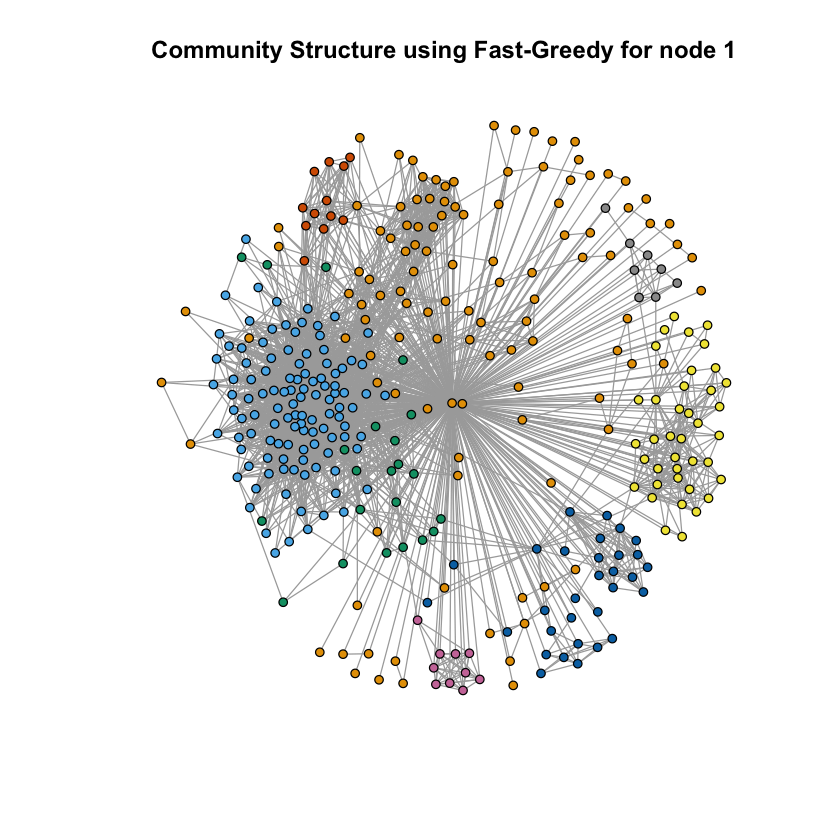

In [150]:
fastgreedy1 = fastgreedy.community(node1_subg)
cat("Modularity score of fast greedy for node 1:", modularity(fastgreedy1), "\n")
plot(node1_subg,
     vertex.color = fastgreedy1$membership,
     vertex.label = NA,
     vertex.size = 3,
     main = print("Community Structure using Fast-Greedy for node 1"))

Modularity score of edge betweenness for node 1: 0.3533022 
[1] "Community Structure using Edge-Betweenness for node 1"


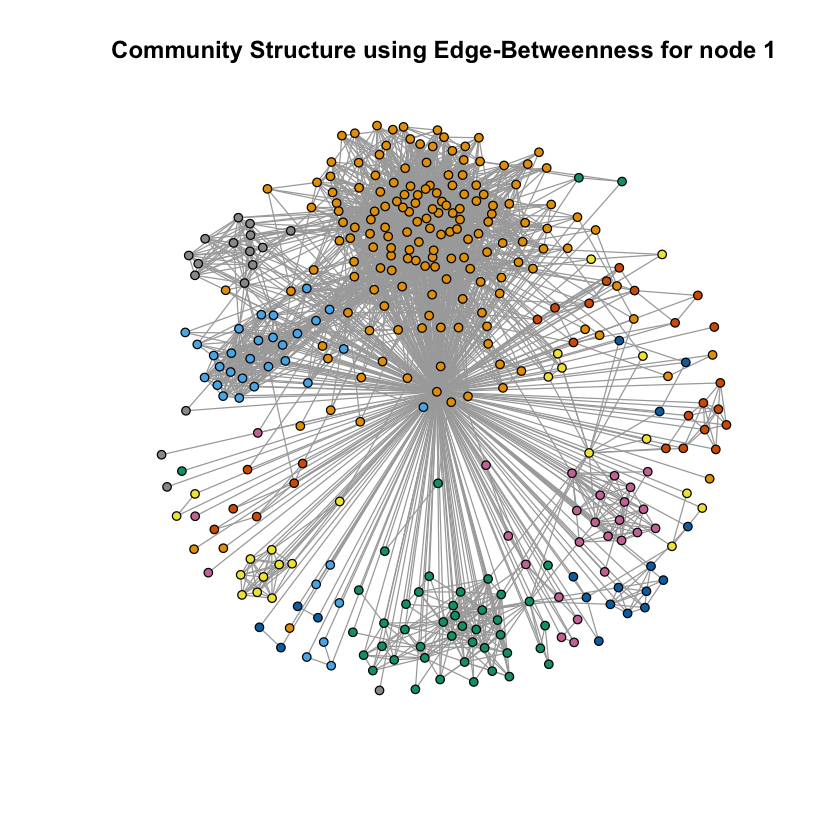

In [151]:
edge_betweenness1 = cluster_edge_betweenness(node1_subg)
cat("Modularity score of edge betweenness for node 1:", modularity(edge_betweenness1), "\n")
plot(node1_subg,
     vertex.color = edge_betweenness1$membership,
     vertex.label = NA,
     vertex.size = 3,
     main = print("Community Structure using Edge-Betweenness for node 1"))

Modularity score of Infomap for node 1: 0.3891185 
[1] "Community Structure using Infomap for node 1"


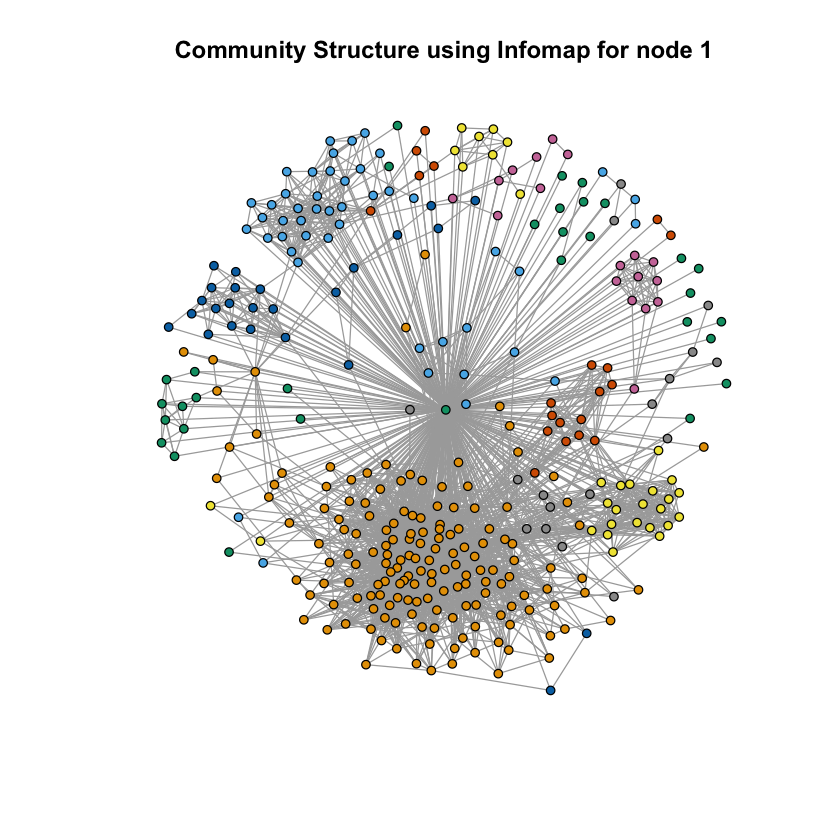

In [152]:
infomap1 = infomap.community(node1_subg)
cat("Modularity score of Infomap for node 1:", modularity(infomap1), "\n")
plot(node1_subg,
     vertex.color = infomap1$membership,
     vertex.label = NA,
     vertex.size = 3,
     main = print("Community Structure using Infomap for node 1"))

#### Node 108

Modularity score of fast greedy for node 108: 0.4359294 
[1] "Community Structure using Fast-Greedy for node 108"


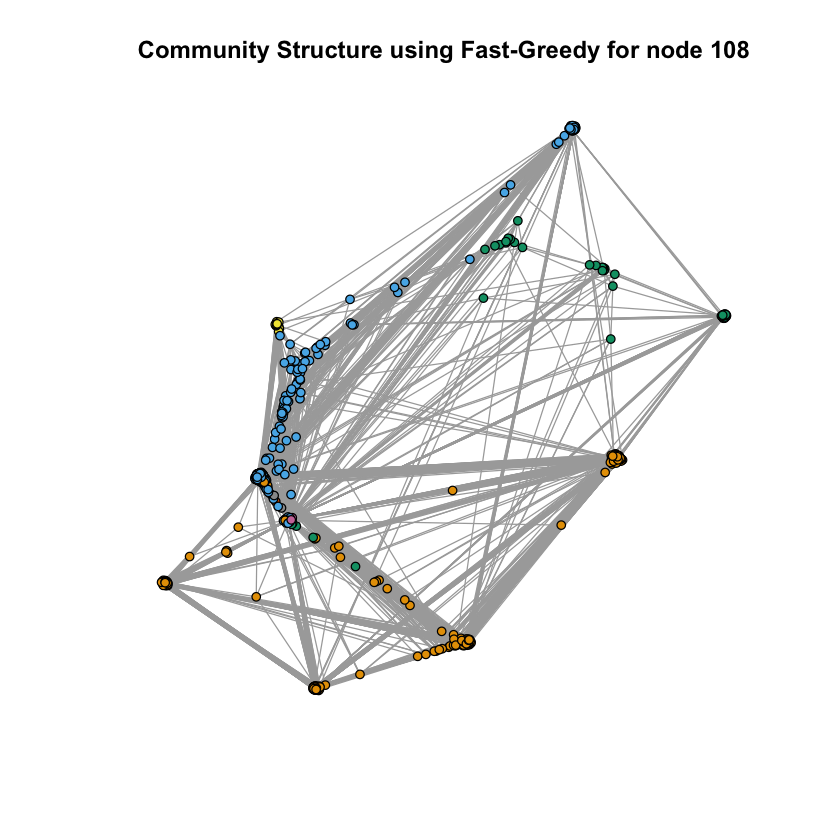

In [153]:
fastgreedy108 = fastgreedy.community(node108_subg)
cat("Modularity score of fast greedy for node 108:", modularity(fastgreedy108), "\n")
plot(node108_subg,
     vertex.color = fastgreedy108$membership,
     vertex.label = NA,
     vertex.size = 3,
     main = print("Community Structure using Fast-Greedy for node 108"))

Modularity score of edge betweenness for node 108: 0.5067549 
[1] "Community Structure using Edge-Betweenness for node 108"


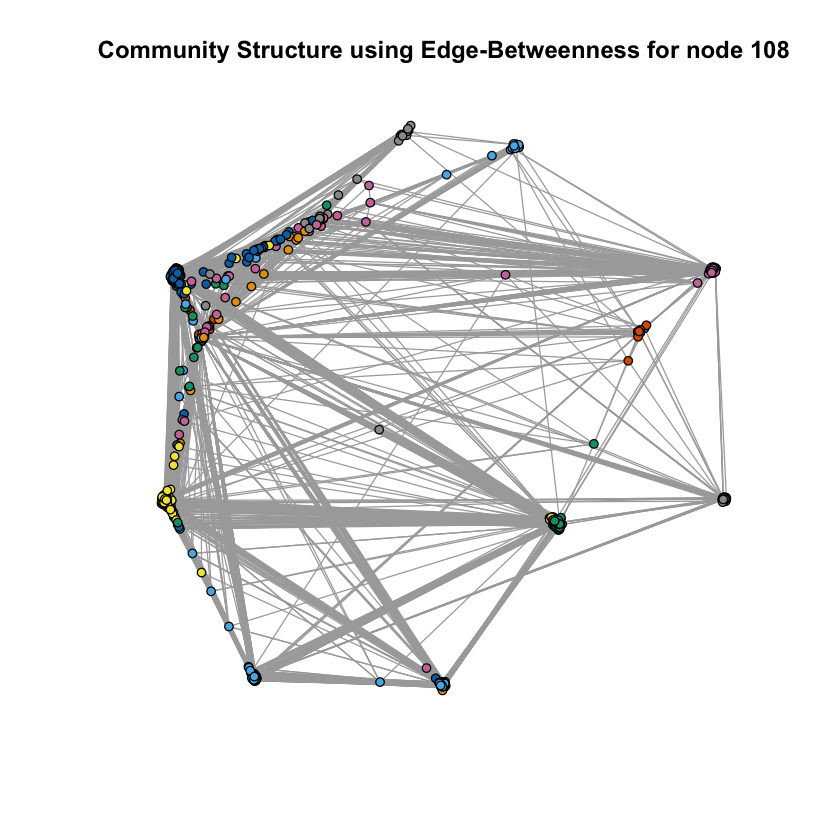

In [154]:
edge_betweenness108 = cluster_edge_betweenness(node108_subg)
cat("Modularity score of edge betweenness for node 108:", modularity(edge_betweenness108), "\n")
plot(node108_subg,
     vertex.color = edge_betweenness108$membership,
     vertex.label = NA,
     vertex.size = 3,
     main = print("Community Structure using Edge-Betweenness for node 108"))

Modularity score of Infomap for node 108: 0.5082492 
[1] "Community Structure using Infomap for node 108"


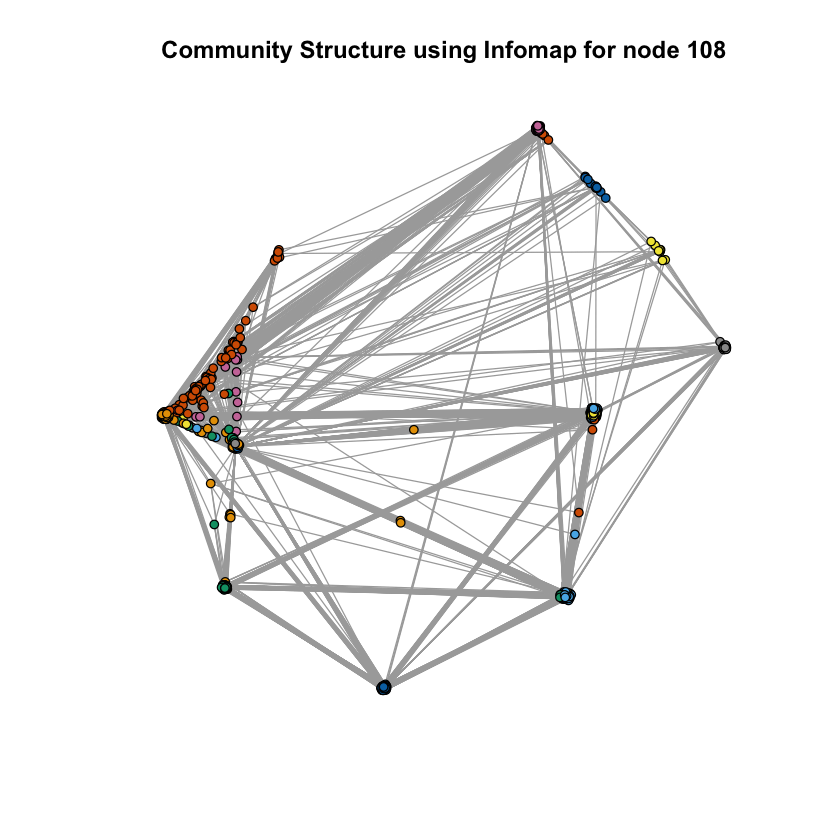

In [155]:
infomap108 = infomap.community(node108_subg)
cat("Modularity score of Infomap for node 108:", modularity(infomap108), "\n")
plot(node108_subg,
     vertex.color = infomap108$membership,
     vertex.label = NA,
     vertex.size = 3,
     main = print("Community Structure using Infomap for node 108"))

#### Node 349

Modularity score of fast greedy for node 349: 0.2517149 
[1] "Community Structure using Fast-Greedy for node 349"


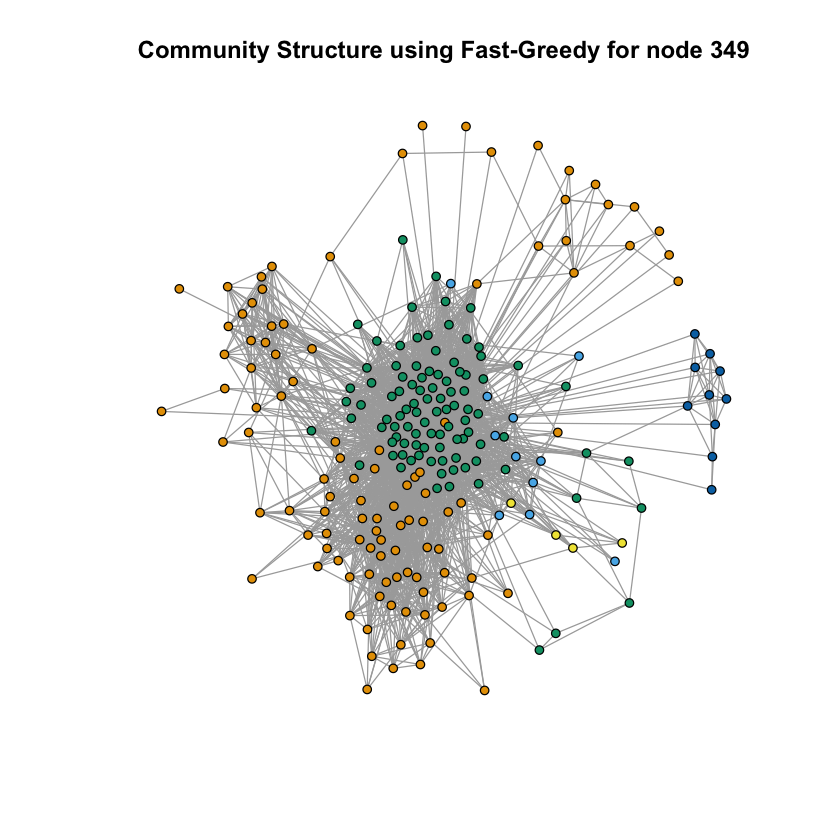

In [156]:
fastgreedy349 = fastgreedy.community(node349_subg)
cat("Modularity score of fast greedy for node 349:", modularity(fastgreedy349), "\n")
plot(node349_subg,
     vertex.color = fastgreedy349$membership,
     vertex.label = NA,
     vertex.size = 3,
     main = print("Community Structure using Fast-Greedy for node 349"))

Modularity score of edge betweenness for node 349: 0.133528 
[1] "Community Structure using Edge-Betweenness for node 349"


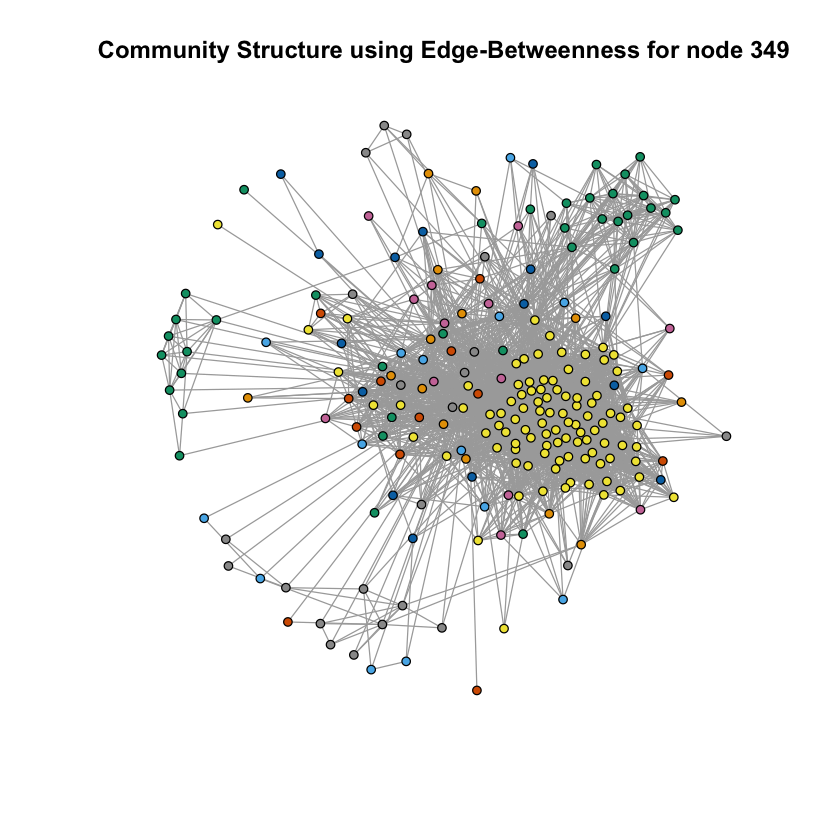

In [157]:
edge_betweenness349 = cluster_edge_betweenness(node349_subg)
cat("Modularity score of edge betweenness for node 349:", modularity(edge_betweenness349), "\n")
plot(node349_subg,
     vertex.color = edge_betweenness349$membership,
     vertex.label = NA,
     vertex.size = 3,
     main = print("Community Structure using Edge-Betweenness for node 349"))

Modularity score of Infomap for node 349: 0.203753 
[1] "Community Structure using Infomap for node 349"


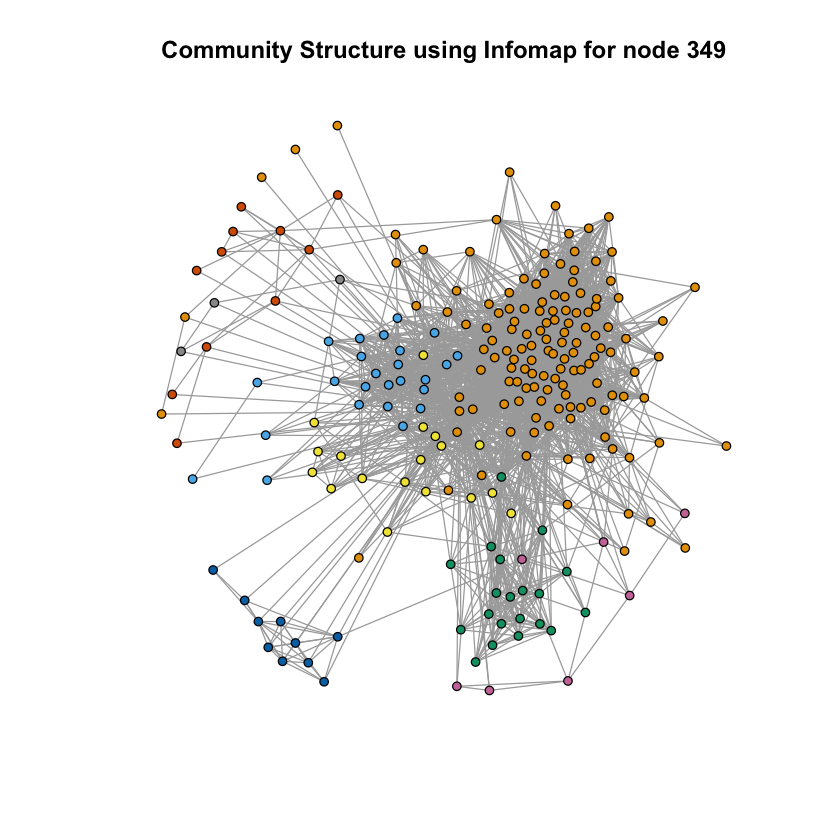

In [158]:
infomap349 = infomap.community(node349_subg)
cat("Modularity score of Infomap for node 349:", modularity(infomap349), "\n")
plot(node349_subg,
     vertex.color = infomap349$membership,
     vertex.label = NA,
     vertex.size = 3,
     main = print("Community Structure using Infomap for node 349"))

#### Node 484

Modularity score of fast greedy for node 484: 0.5070016 
[1] "Community Structure using Fast-Greedy for node 484"


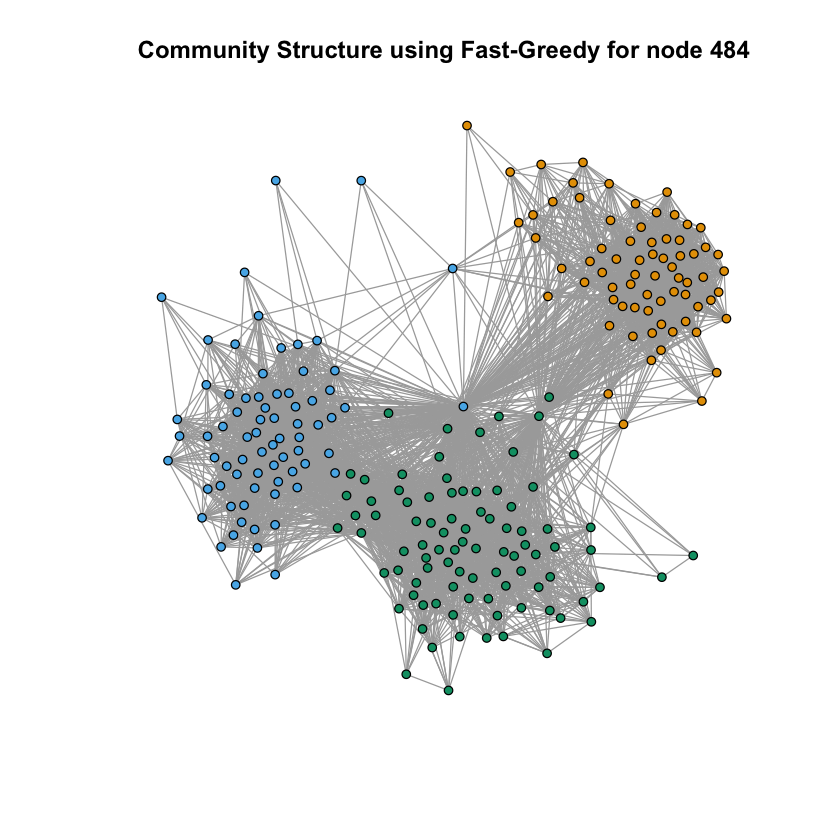

In [159]:
fastgreedy484 = fastgreedy.community(node484_subg)
cat("Modularity score of fast greedy for node 484:", modularity(fastgreedy484), "\n")
plot(node484_subg,
     vertex.color = fastgreedy484$membership,
     vertex.label = NA,
     vertex.size = 3,
     main = print("Community Structure using Fast-Greedy for node 484"))

Modularity score of edge betweenness for node 484: 0.4890952 
[1] "Community Structure using Edge-Betweenness for node 484"


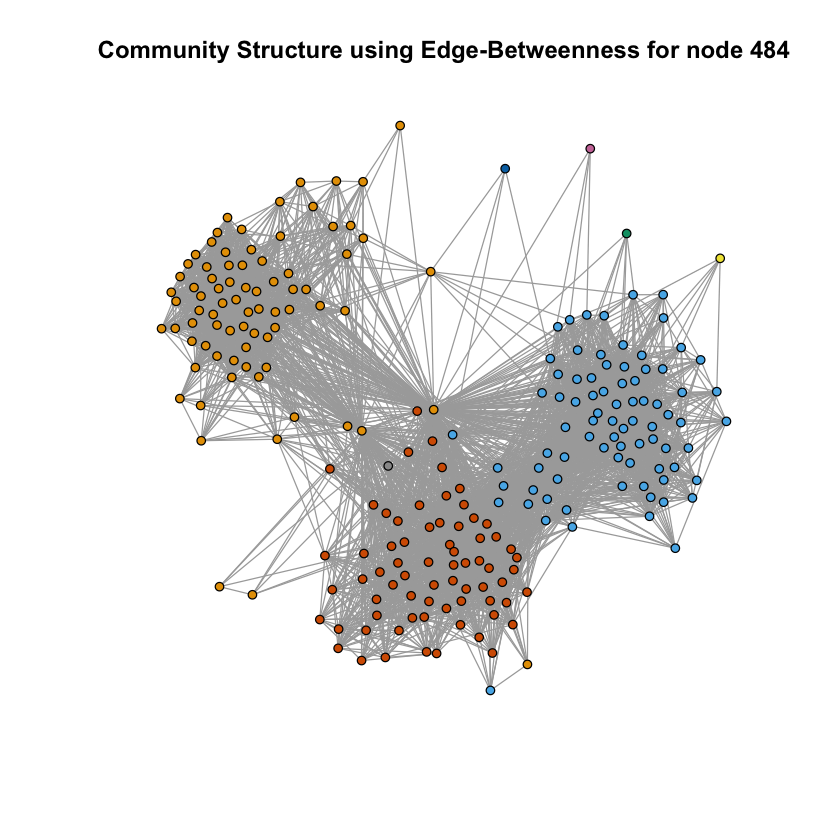

In [160]:
edge_betweenness484 = cluster_edge_betweenness(node484_subg)
cat("Modularity score of edge betweenness for node 484:", modularity(edge_betweenness484), "\n")
plot(node484_subg,
     vertex.color = edge_betweenness484$membership,
     vertex.label = NA,
     vertex.size = 3,
     main = print("Community Structure using Edge-Betweenness for node 484"))

Modularity score of Infomap for node 484: 0.5152788 
[1] "Community Structure using Infomap for node 484"


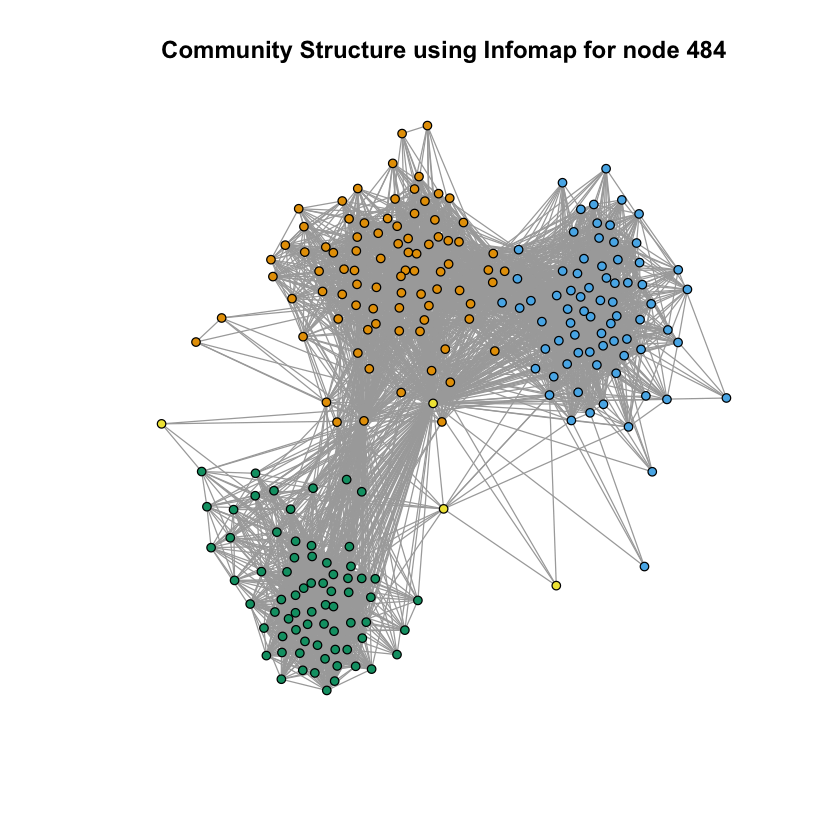

In [161]:
infomap484 = infomap.community(node484_subg)
cat("Modularity score of Infomap for node 484:", modularity(infomap484), "\n")
plot(node484_subg,
     vertex.color = infomap484$membership,
     vertex.label = NA,
     vertex.size = 3,
     main = print("Community Structure using Infomap for node 484"))

#### Node 1087

Modularity score of fast greedy for node 1087: 0.1455315 
[1] "Community Structure using Fast-Greedy for node 1087"


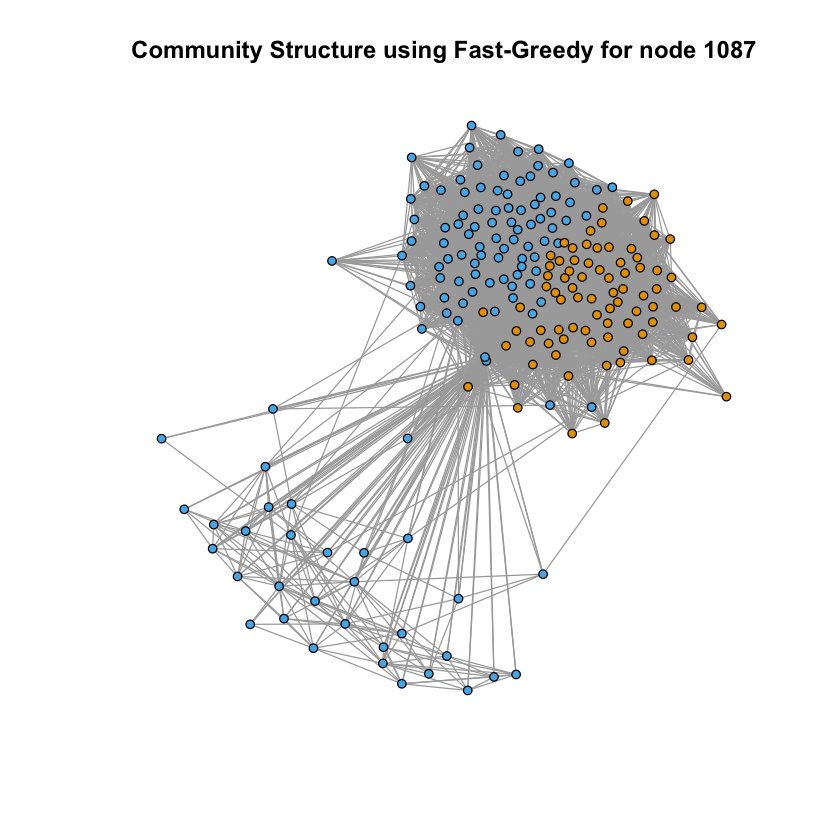

In [162]:
fastgreedy1087 = fastgreedy.community(node1087_subg)
cat("Modularity score of fast greedy for node 1087:", modularity(fastgreedy1087), "\n")
plot(node1087_subg,
     vertex.color = fastgreedy1087$membership,
     vertex.label = NA,
     vertex.size = 3,
     main = print("Community Structure using Fast-Greedy for node 1087"))

Modularity score of edge betweenness for node 1087: 0.02762377 
[1] "Community Structure using Edge-Betweenness for node 1087"


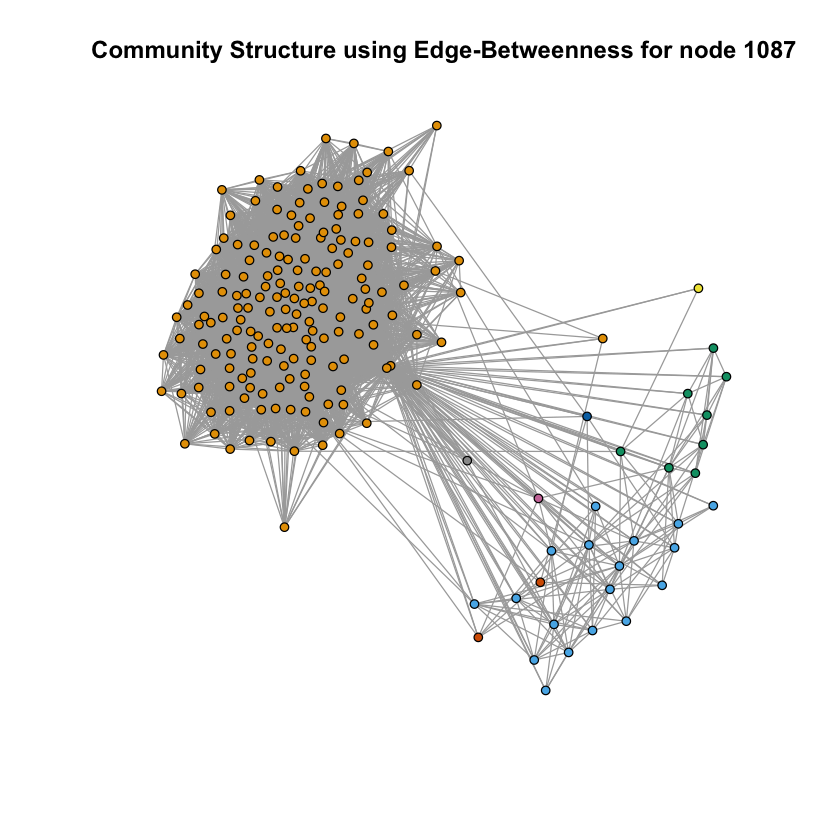

In [163]:
edge_betweenness1087 = cluster_edge_betweenness(node1087_subg)
cat("Modularity score of edge betweenness for node 1087:", modularity(edge_betweenness1087), "\n")
plot(node1087_subg,
     vertex.color = edge_betweenness1087$membership,
     vertex.label = NA,
     vertex.size = 3,
     main = print("Community Structure using Edge-Betweenness for node 1087"))

Modularity score of Infomap for node 1087: 0.02690662 
[1] "Community Structure using Infomap for node 1087"


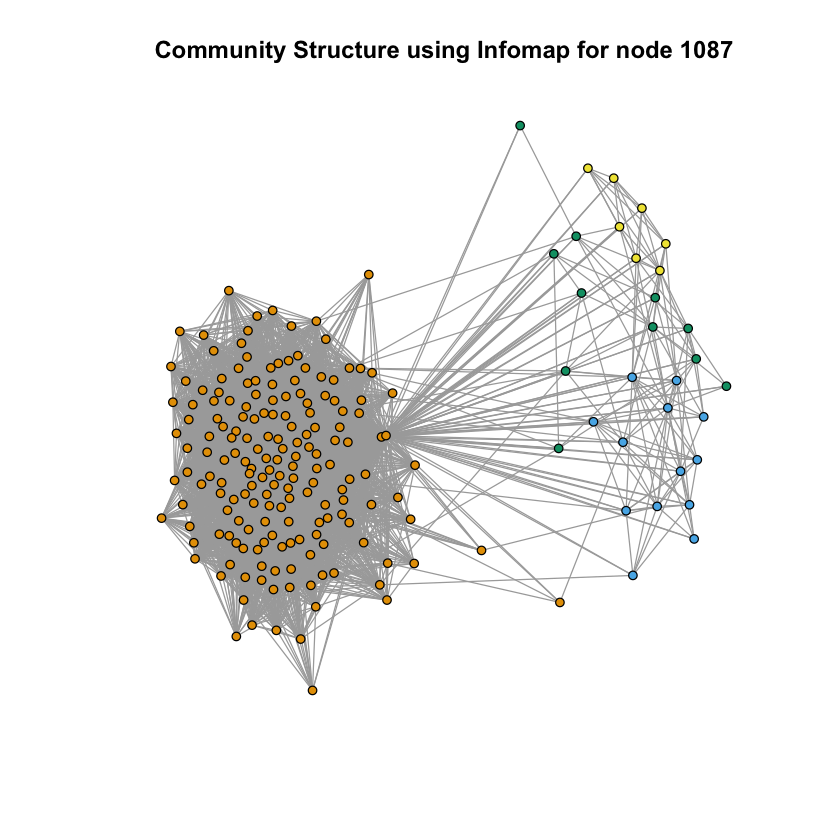

In [164]:
infomap1087 = infomap.community(node1087_subg)
cat("Modularity score of Infomap for node 1087:", modularity(infomap1087), "\n")
plot(node1087_subg,
     vertex.color = infomap1087$membership,
     vertex.label = NA,
     vertex.size = 3,
     main = print("Community Structure using Infomap for node 1087"))

### 3.2. Community structure with the core node removed

In this part, we will explore the eﬀect on the community structure of a core node’s personalized network when the core node itself is removed from the personalized network.

### Question 10

For each of the core node’s personalized network (use same core nodes as Question 9), remove the core node from the personalized network and ﬁnd the community structure of the modiﬁed personalized network. Use the same community detection algorithm as Question 9. Compare the modularity score of the community structure of the modiﬁed personalized network with the modularity score of the community structure of the personalized network of Question 9. For visualization purpose, display the community structure of the modiﬁed personalized network using colors. In this question, you should have 15 plots in total.

In [165]:
node1_subg_no_core = induced.subgraph(fb_graph, neighbors(fb_graph, 1))
node108_subg_no_core = induced.subgraph(fb_graph, neighbors(fb_graph, 108))
node349_subg_no_core = induced.subgraph(fb_graph, neighbors(fb_graph, 349))
node484_subg_no_core = induced.subgraph(fb_graph, neighbors(fb_graph, 484))
node1087_subg_no_core = induced.subgraph(fb_graph, neighbors(fb_graph, 1087))

#### Node 1

Modularity score of fast greedy for node 1 (without core): 0.4418533 
[1] "Community Structure using Fast-Greedy for node 1\n(without core)"


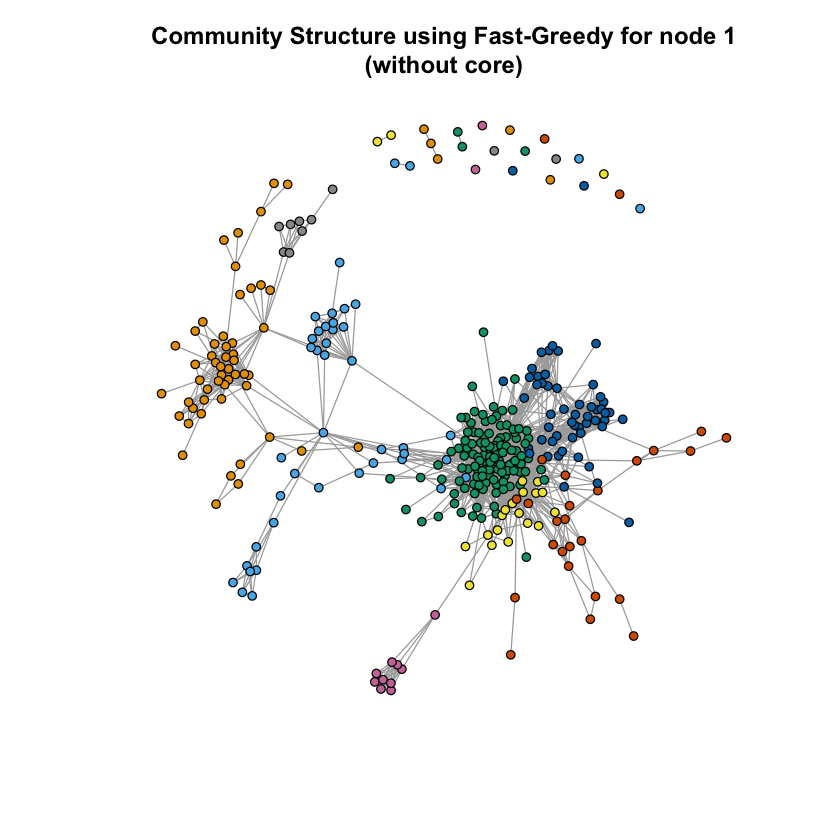

In [166]:
fastgreedy1 = fastgreedy.community(node1_subg_no_core)
cat("Modularity score of fast greedy for node 1 (without core):", modularity(fastgreedy1), "\n")
plot(node1_subg_no_core,
     vertex.color = fastgreedy1$membership,
     vertex.label = NA,
     vertex.size = 3,
     main = print("Community Structure using Fast-Greedy for node 1\n(without core)"))

Modularity score of edge betweenness for node 1 (without core): 0.4161461 
[1] "Community Structure using Edge-Betweenness for node 1\n(without core)"


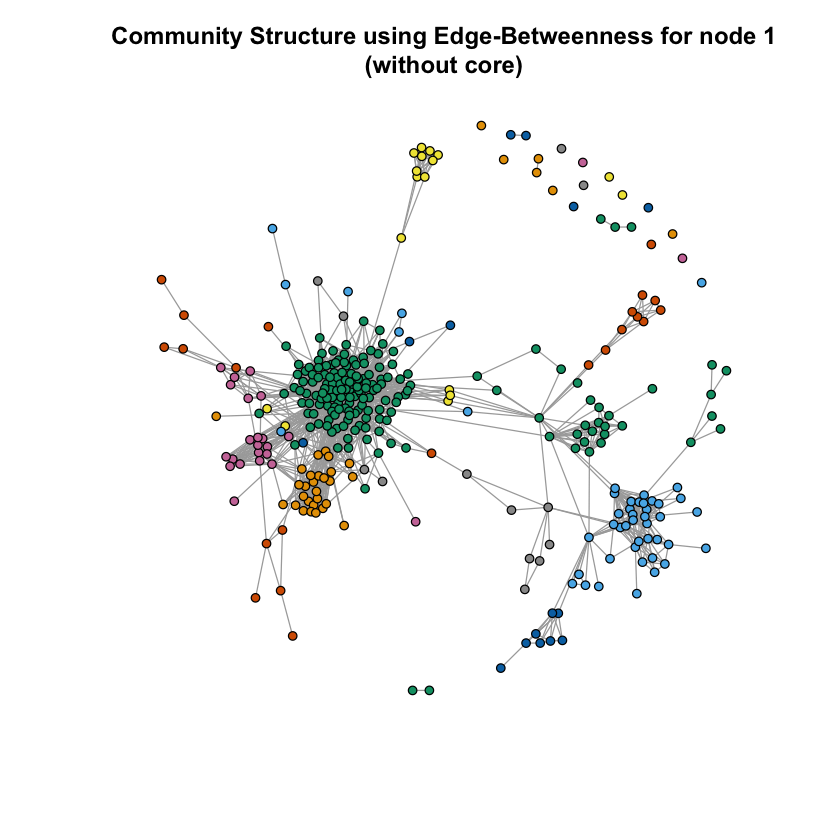

In [167]:
edge_betweenness1 = cluster_edge_betweenness(node1_subg_no_core)
cat("Modularity score of edge betweenness for node 1 (without core):", modularity(edge_betweenness1), "\n")
plot(node1_subg_no_core,
     vertex.color = edge_betweenness1$membership,
     vertex.label = NA,
     vertex.size = 3,
     main = print("Community Structure using Edge-Betweenness for node 1\n(without core)"))

Modularity score of Infomap for node 1 (without core): 0.4180077 
[1] "Community Structure using Infomap for node 1\n(without core)"


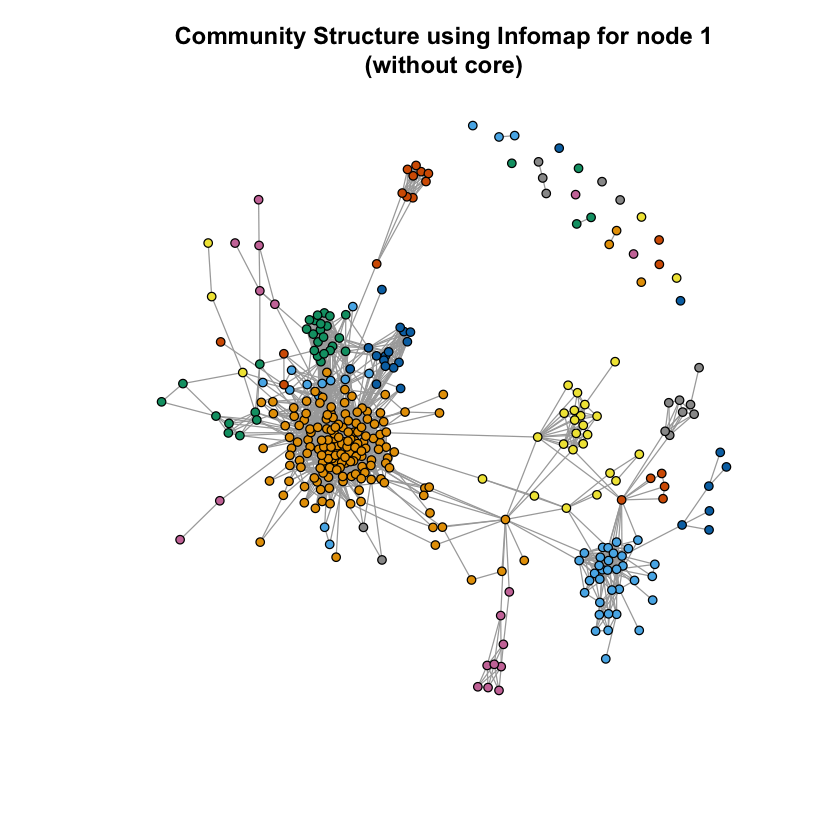

In [168]:
infomap1 = infomap.community(node1_subg_no_core)
cat("Modularity score of Infomap for node 1 (without core):", modularity(infomap1), "\n")
plot(node1_subg_no_core,
     vertex.color = infomap1$membership,
     vertex.label = NA,
     vertex.size = 3,
     main = print("Community Structure using Infomap for node 1\n(without core)"))

#### Node 108

Modularity score of fast greedy for node 108 (without core): 0.4581271 
[1] "Community Structure using Fast-Greedy for node 108\n(without core)"


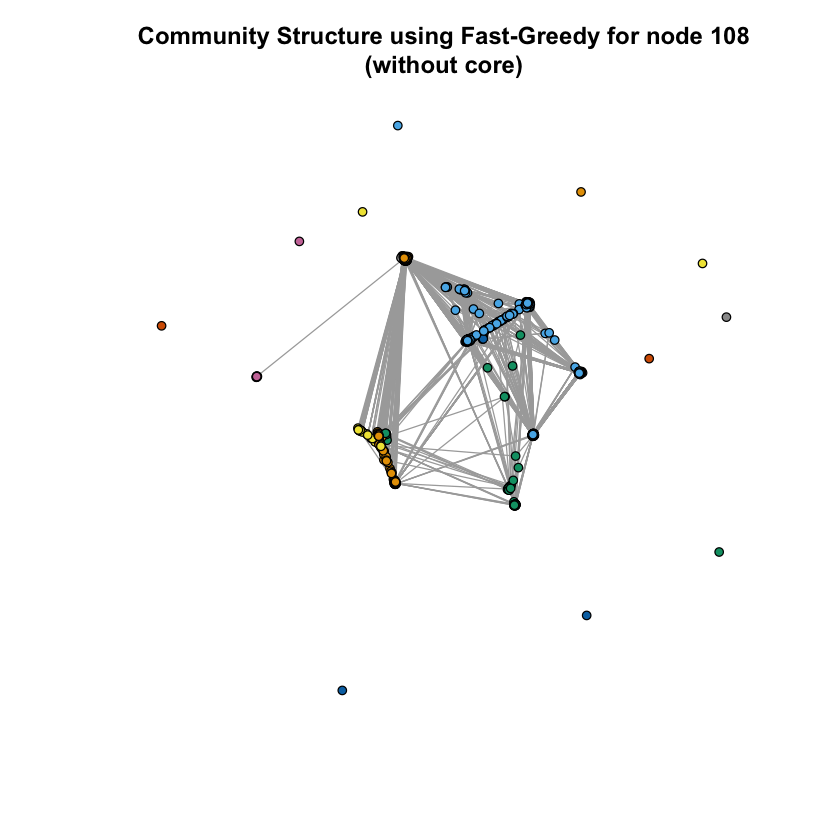

In [169]:
fastgreedy108 = fastgreedy.community(node108_subg_no_core)
cat("Modularity score of fast greedy for node 108 (without core):", modularity(fastgreedy108), "\n")
plot(node108_subg_no_core,
     vertex.color = fastgreedy108$membership,
     vertex.label = NA,
     vertex.size = 3,
     main = print("Community Structure using Fast-Greedy for node 108\n(without core)"))

Modularity score of edge betweenness for node 108 (without grapgh): 0.5213216 
[1] "Community Structure using Edge-Betweenness for node 108\n(without grapgh)"


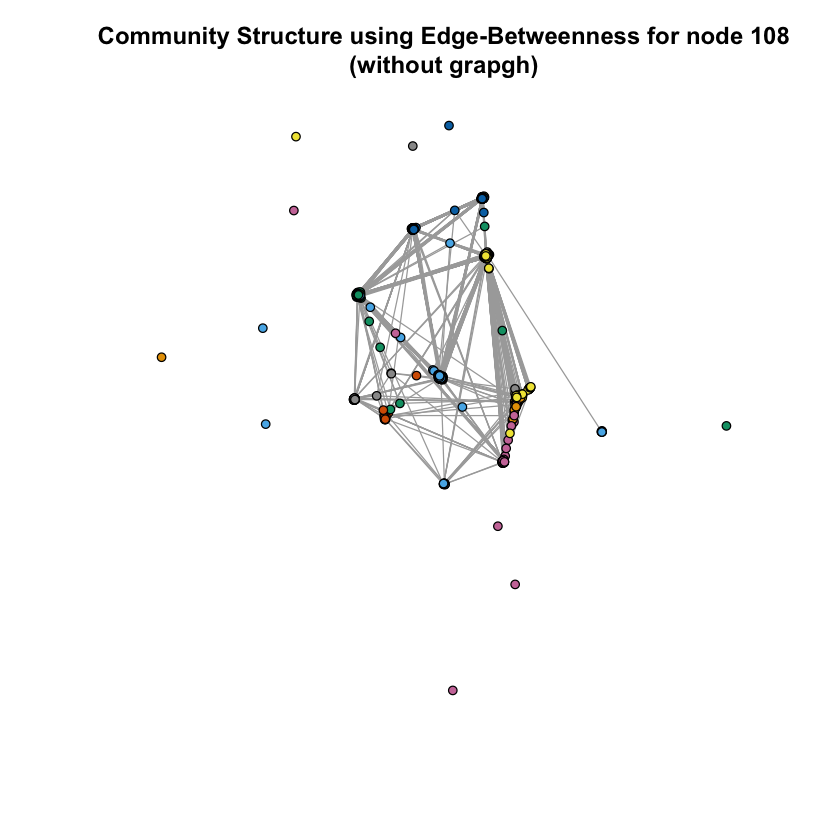

In [170]:
edge_betweenness108 = cluster_edge_betweenness(node108_subg_no_core)
cat("Modularity score of edge betweenness for node 108 (without grapgh):", modularity(edge_betweenness108), "\n")
plot(node108_subg_no_core,
     vertex.color = edge_betweenness108$membership,
     vertex.label = NA,
     vertex.size = 3,
     main = print("Community Structure using Edge-Betweenness for node 108\n(without grapgh)"))

Modularity score of Infomap for node 108 (without grapgh): 0.5207602 
[1] "Community Structure using Infomap for node 108\n(without grapgh)"


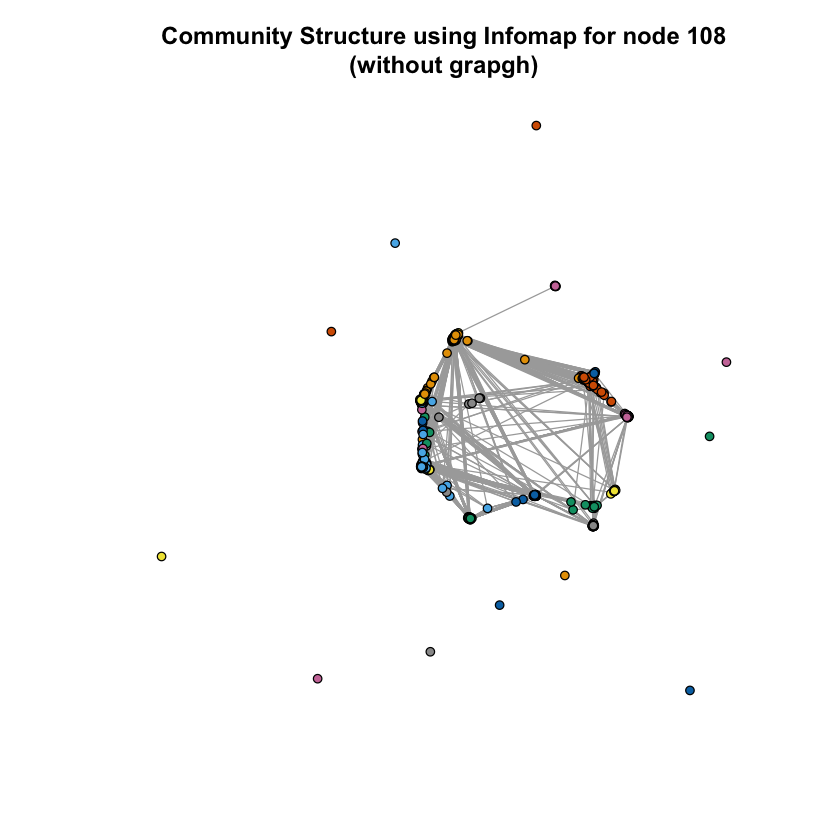

In [171]:
infomap108 = infomap.community(node108_subg_no_core)
cat("Modularity score of Infomap for node 108 (without grapgh):", modularity(infomap108), "\n")
plot(node108_subg_no_core,
     vertex.color = infomap108$membership,
     vertex.label = NA,
     vertex.size = 3,
     main = print("Community Structure using Infomap for node 108\n(without grapgh)"))

#### Node 349

Modularity score of fast greedy for node 349 (without core): 0.2456918 
[1] "Community Structure using Fast-Greedy for node 349\n(without core)"


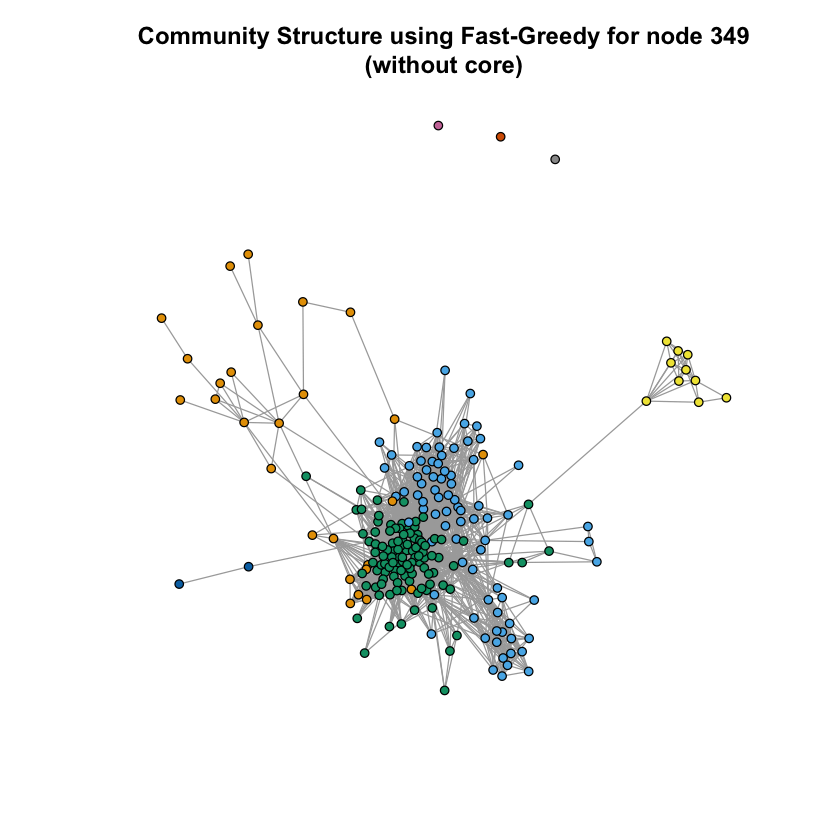

In [172]:
fastgreedy349 = fastgreedy.community(node349_subg_no_core)
cat("Modularity score of fast greedy for node 349 (without core):", modularity(fastgreedy349), "\n")
plot(node349_subg_no_core,
     vertex.color = fastgreedy349$membership,
     vertex.label = NA,
     vertex.size = 3,
     main = print("Community Structure using Fast-Greedy for node 349\n(without core)"))

Modularity score of edge betweenness for node 349 (without grapgh): 0.1505663 
[1] "Community Structure using Edge-Betweenness for node 349\n(without grapgh)"


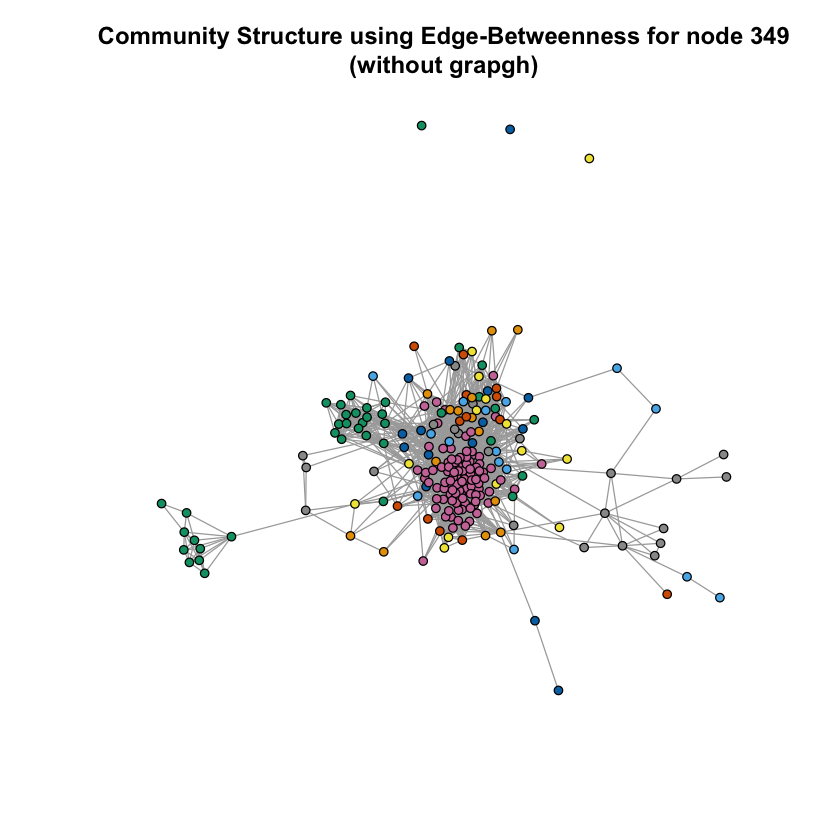

In [173]:
edge_betweenness349 = cluster_edge_betweenness(node349_subg_no_core)
cat("Modularity score of edge betweenness for node 349 (without grapgh):", modularity(edge_betweenness349), "\n")
plot(node349_subg_no_core,
     vertex.color = edge_betweenness349$membership,
     vertex.label = NA,
     vertex.size = 3,
     main = print("Community Structure using Edge-Betweenness for node 349\n(without grapgh)"))

Modularity score of Infomap for node 349 (without grapgh): 0.2448156 
[1] "Community Structure using Infomap for node 349\n(without grapgh)"


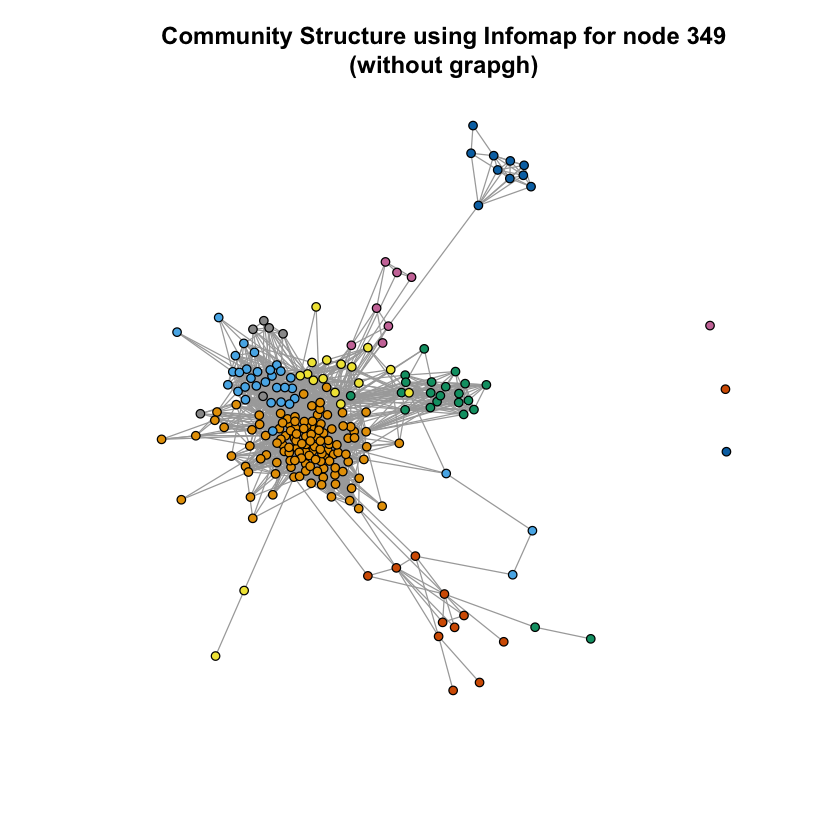

In [174]:
infomap349 = infomap.community(node349_subg_no_core)
cat("Modularity score of Infomap for node 349 (without grapgh):", modularity(infomap349), "\n")
plot(node349_subg_no_core,
     vertex.color = infomap349$membership,
     vertex.label = NA,
     vertex.size = 3,
     main = print("Community Structure using Infomap for node 349\n(without grapgh)"))

#### Node 484

Modularity score of fast greedy for node 484 (without core): 0.5342142 
[1] "Community Structure using Fast-Greedy for node 484\n(without core)"


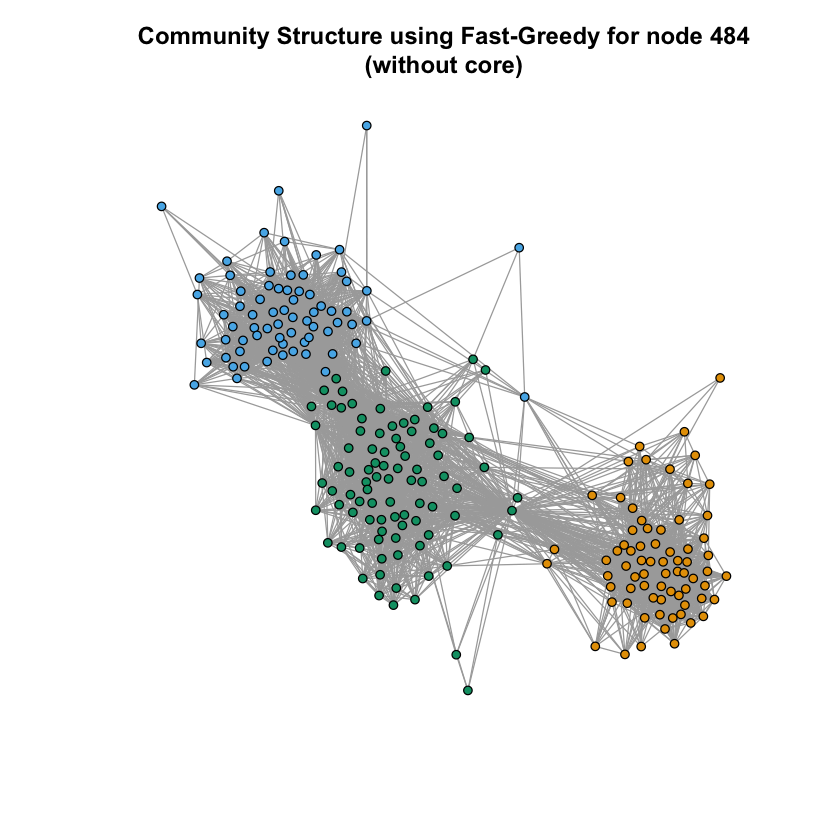

In [175]:
fastgreedy484 = fastgreedy.community(node484_subg_no_core)
cat("Modularity score of fast greedy for node 484 (without core):", modularity(fastgreedy484), "\n")
plot(node484_subg_no_core,
     vertex.color = fastgreedy484$membership,
     vertex.label = NA,
     vertex.size = 3,
     main = print("Community Structure using Fast-Greedy for node 484\n(without core)"))

Modularity score of edge betweenness for node 484 (without grapgh): 0.5154413 
[1] "Community Structure using Edge-Betweenness for node 484\n(without grapgh)"


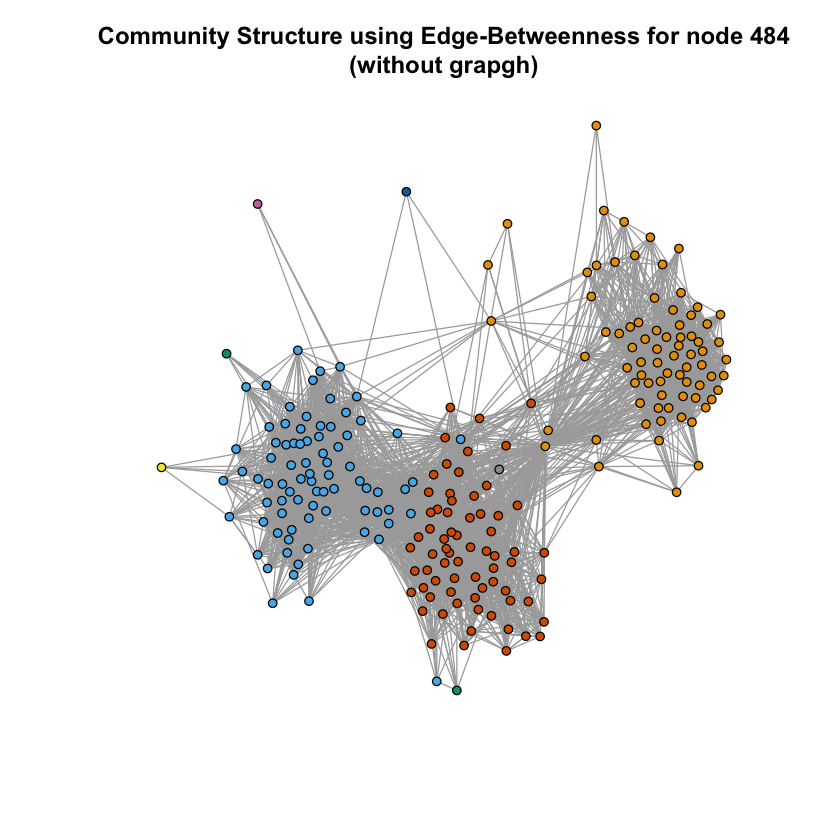

In [176]:
edge_betweenness484 = cluster_edge_betweenness(node484_subg_no_core)
cat("Modularity score of edge betweenness for node 484 (without grapgh):", modularity(edge_betweenness484), "\n")
plot(node484_subg_no_core,
     vertex.color = edge_betweenness484$membership,
     vertex.label = NA,
     vertex.size = 3,
     main = print("Community Structure using Edge-Betweenness for node 484\n(without grapgh)"))

Modularity score of Infomap for node 484 (without grapgh): 0.5434437 
[1] "Community Structure using Infomap for node 484\n(without grapgh)"


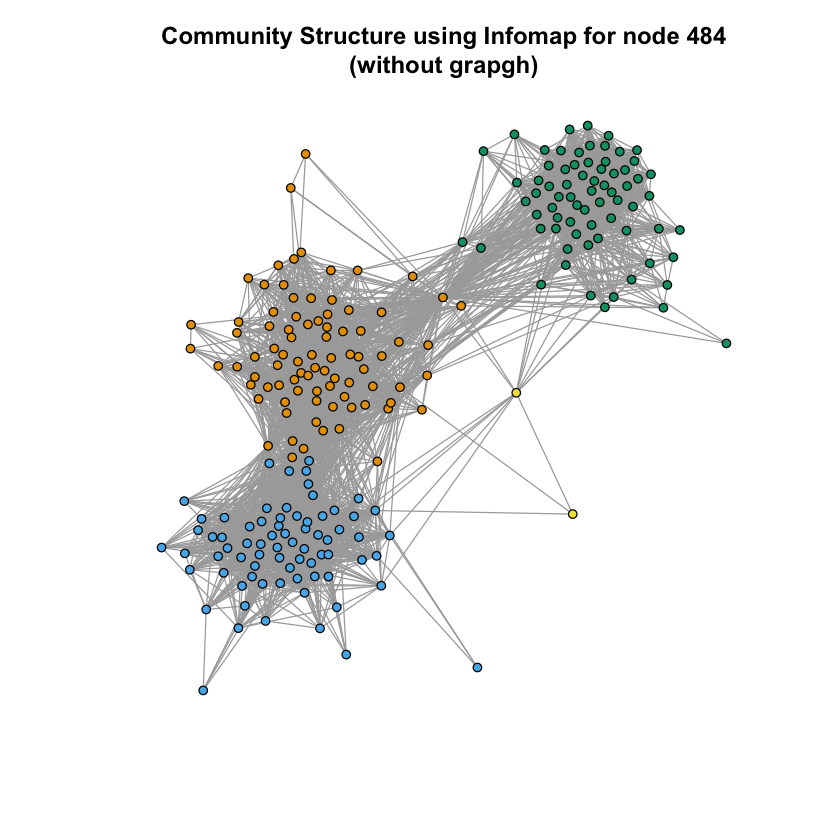

In [177]:
infomap484 = infomap.community(node484_subg_no_core)
cat("Modularity score of Infomap for node 484 (without grapgh):", modularity(infomap484), "\n")
plot(node484_subg_no_core,
     vertex.color = infomap484$membership,
     vertex.label = NA,
     vertex.size = 3,
     main = print("Community Structure using Infomap for node 484\n(without grapgh)"))

#### Node 1087

Modularity score of fast greedy for node 1087 (without core): 0.1481956 
[1] "Community Structure using Fast-Greedy for node 1087\n(without core)"


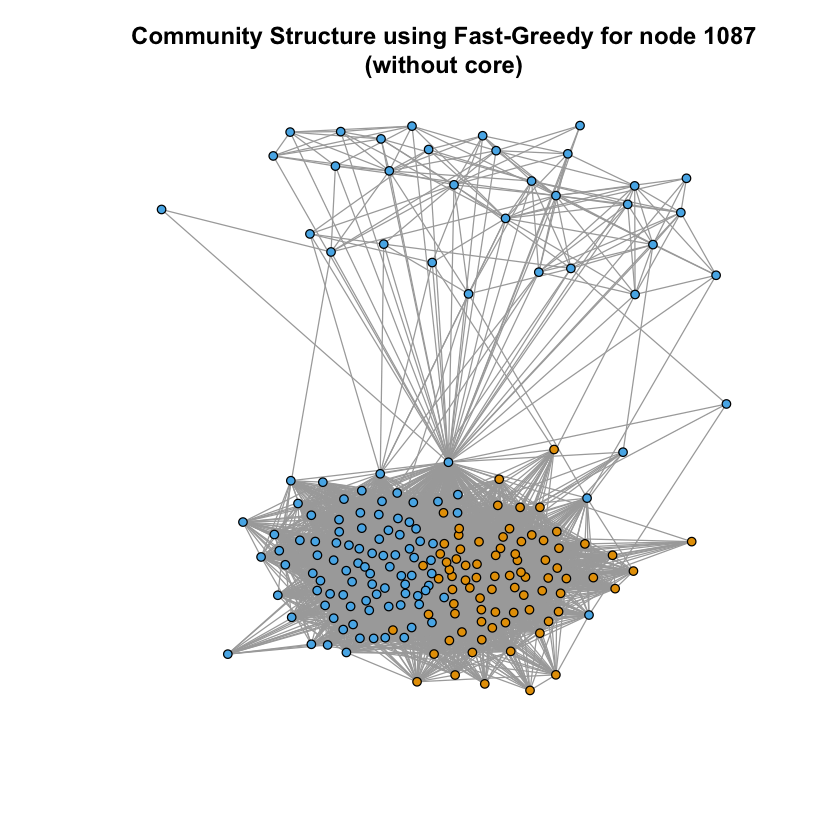

In [178]:
fastgreedy1087 = fastgreedy.community(node1087_subg_no_core)
cat("Modularity score of fast greedy for node 1087 (without core):", modularity(fastgreedy1087), "\n")
plot(node1087_subg_no_core,
     vertex.color = fastgreedy1087$membership,
     vertex.label = NA,
     vertex.size = 3,
     main = print("Community Structure using Fast-Greedy for node 1087\n(without core)"))

Modularity score of edge betweenness for node 1087 (without grapgh): 0.0324953 
[1] "Community Structure using Edge-Betweenness for node 1087\n(without grapgh)"


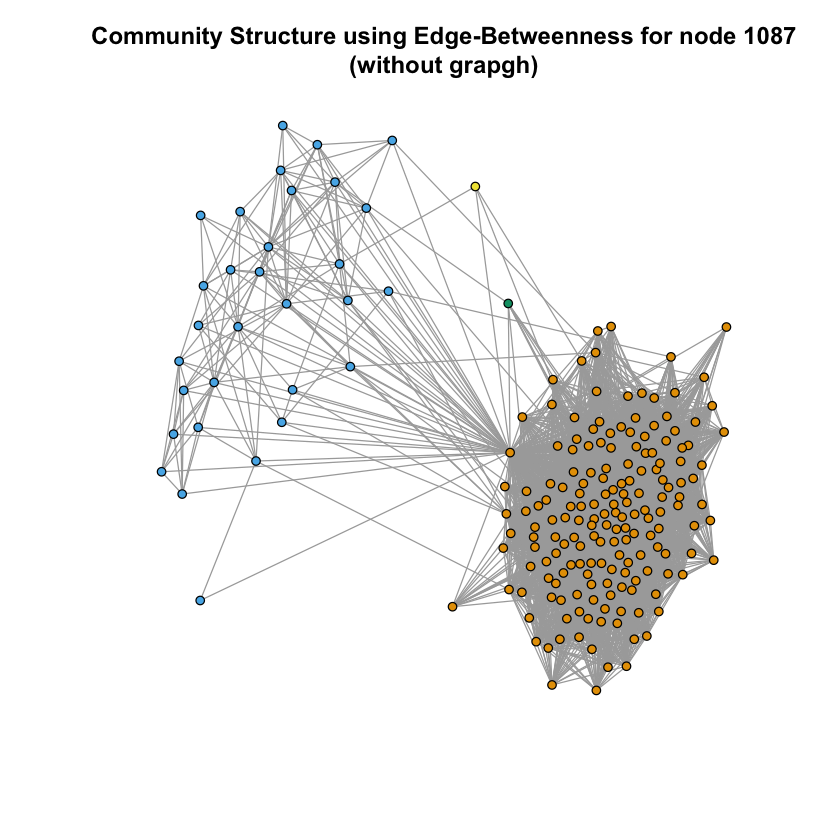

In [179]:
edge_betweenness1087 = cluster_edge_betweenness(node1087_subg_no_core)
cat("Modularity score of edge betweenness for node 1087 (without grapgh):", modularity(edge_betweenness1087), "\n")
plot(node1087_subg_no_core,
     vertex.color = edge_betweenness1087$membership,
     vertex.label = NA,
     vertex.size = 3,
     main = print("Community Structure using Edge-Betweenness for node 1087\n(without grapgh)"))

Modularity score of Infomap for node 1087 (without grapgh): 0.02737159 
[1] "Community Structure using Infomap for node 1087\n(without grapgh)"


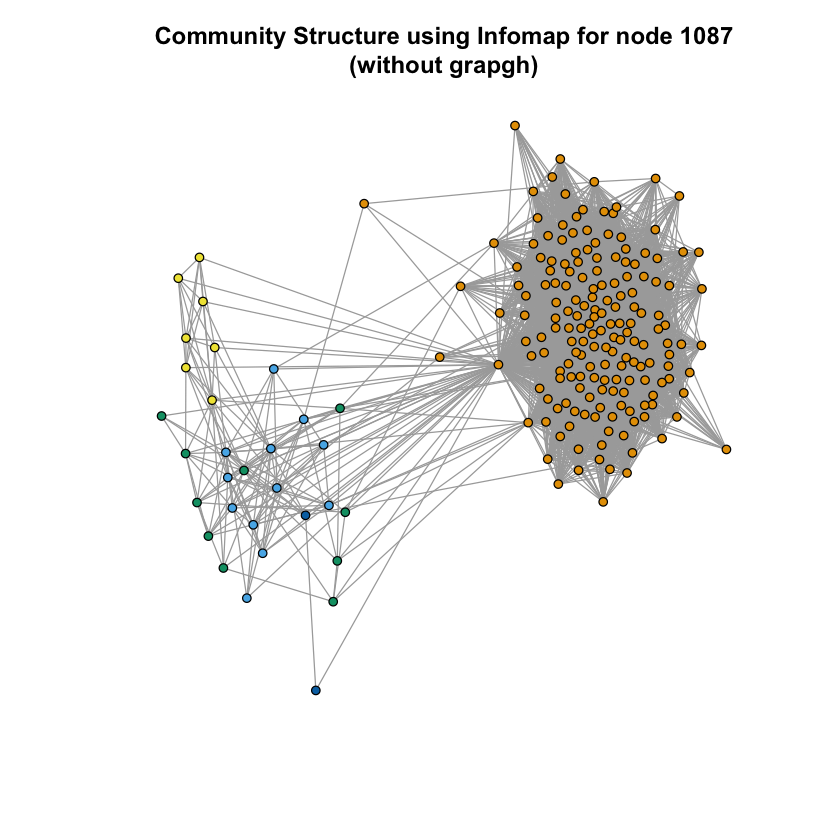

In [180]:
infomap1087 = infomap.community(node1087_subg_no_core)
cat("Modularity score of Infomap for node 1087 (without grapgh):", modularity(infomap1087), "\n")
plot(node1087_subg_no_core,
     vertex.color = infomap1087$membership,
     vertex.label = NA,
     vertex.size = 3,
     main = print("Community Structure using Infomap for node 1087\n(without grapgh)"))

### 3.3. Characteristic of nodes in the personalized network

In this part, we will explore characteristics of nodes in the personalized network using two measures. These two measures are stated and deﬁned below:
* <b>Embeddedness</b> of a node is deﬁned as the number of mutual friends a node shares with the core node. 
* <b>Dispersion</b> of a node is deﬁned as the sum of distances between every pair of the mutual friends the node shares with the core node. The distances should be calculated in a modiﬁed graph where the node (whose dispersion is being computed) and the core node are removed.

For further details on the above characteristics, you can read the paper below:

http://arxiv.org/abs/1310.6753

### Question 11

Write an expression relating the Embeddedness of a node to it’s degree.

$$Embeddedness(node) = degree(node) - 1$$

### Question 12

For each of the core node’s personalized network (use the same core nodes as Question 9), plot the distribution of embeddedness and dispersion. In this question, you will have 10 plots.

In [181]:
cal_embeddedness = function(graph, node) {
    return (degree(graph, v = node) - 1)
}

In [182]:
cal_dispersion = function(graph, core, node) {
    V(graph)$name = V(graph)
    modified_graph1 = delete.vertices(graph, core)
    
    mutual_nodes = neighbors(modified_graph1, V(modified_graph1)$name == node)$name
    
    modified_graph1 = delete.vertices(graph, c(node, core))
    
    total_dist = 0
    d = diameter(graph)
    constant = 2
    for(i in 1 : (length(mutual_nodes) - 1)) {
        for(j in (i + 1) : length(mutual_nodes)) {
            temp_dist = distances(modified_graph1, 
                                  which(V(modified_graph1)$name == mutual_nodes[i]), 
                                  which(V(modified_graph1)$name == mutual_nodes[j]))
            if(length(temp_dist) == 0 || is.infinite(temp_dist)) {
                temp_dist = d + constant
            }
            total_dist = total_dist + temp_dist[1][1]
            
        }
    }
    return (total_dist)
}

In [183]:
plot_emb_hist = function(graph, core) {
    V(graph)$name = V(graph)
    sub_graph = induced.subgraph(graph, c(core, neighbors(graph, core)))
    
    embeddedness = numeric(0)
    all_neigbour = neighbors(sub_graph, which(V(sub_graph)$name == core))
    for(i in 1 : length(all_neigbour)) {
        curr_embd = cal_embeddedness(sub_graph, all_neigbour[i])
        embeddedness = c(embeddedness, curr_embd)
    }
    hist(embeddedness, 
         breaks=50, 
         main = sprintf("Embeddedness Distribution (core: %i)", core), 
         xlab = "Embeddedness")
}

In [184]:
plot_disp_hist = function(graph, core) {
    V(graph)$name = V(graph)
    sub_graph = induced.subgraph(graph, c(core, neighbors(graph, core)))
    
    dispersion = numeric(0)
    all_neigbour = neighbors(sub_graph, which(V(sub_graph)$name == core))$name
    for(i in 1 : length(all_neigbour)) { 
        curr_core = which(V(sub_graph)$name == core)
        curr_node = which(V(sub_graph)$name == all_neigbour[i])
        curr_disp = cal_dispersion(sub_graph, curr_core, curr_node)
        dispersion = c(dispersion, curr_disp)
    }
    
    hist(dispersion, 
         breaks=50, 
         main = sprintf("Dispersion Distribution (core: %i)", core), 
         xlab = "Dispersion")
}

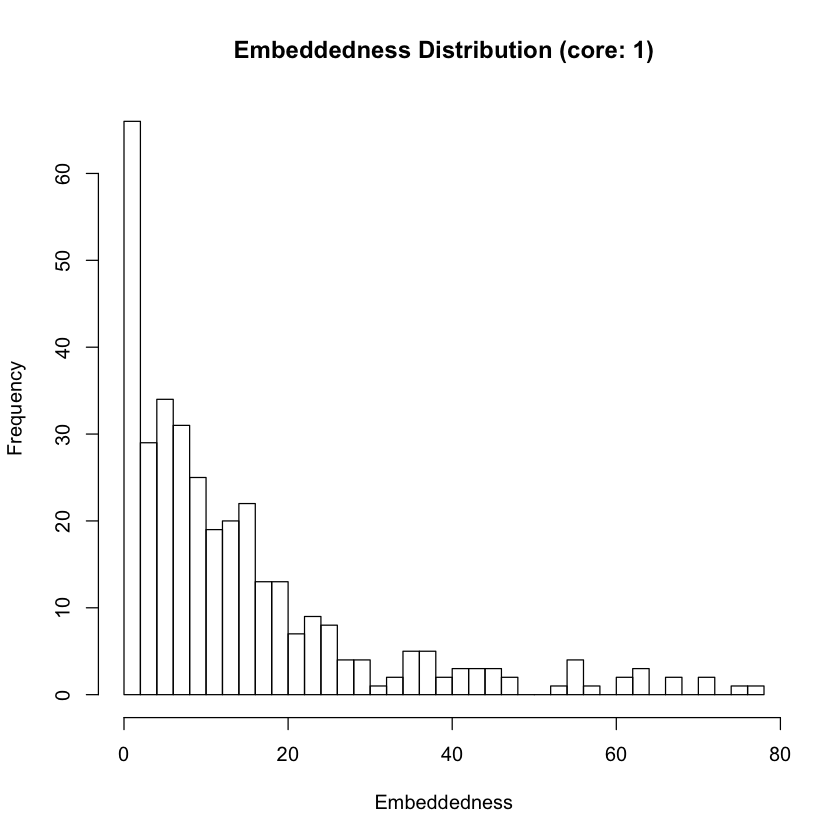

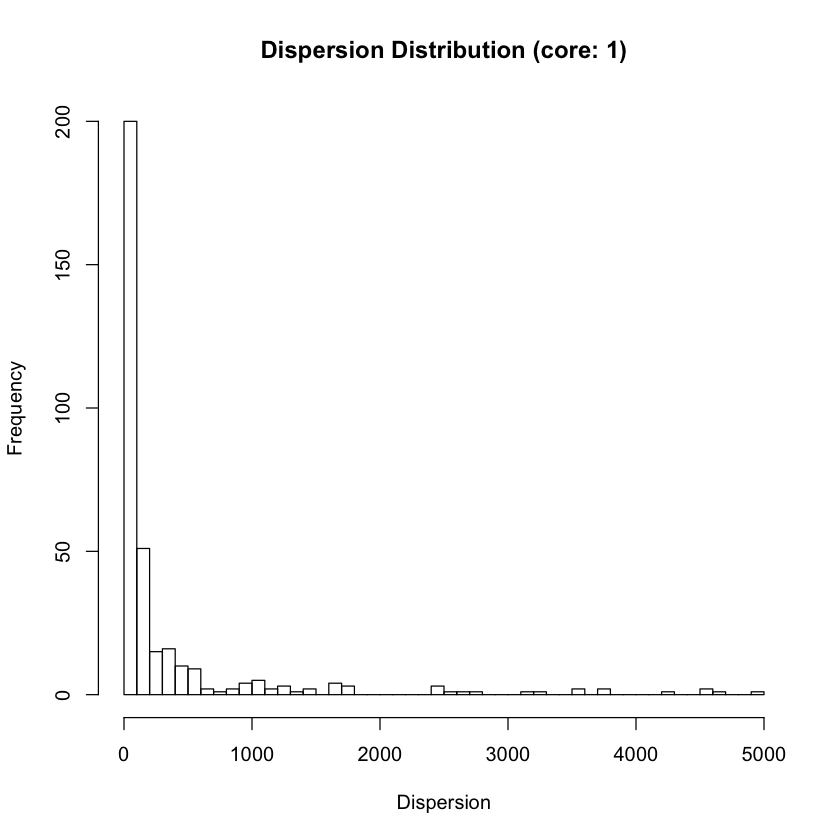

In [185]:
plot_emb_hist(fb_graph, 1)
plot_disp_hist(fb_graph, 1)

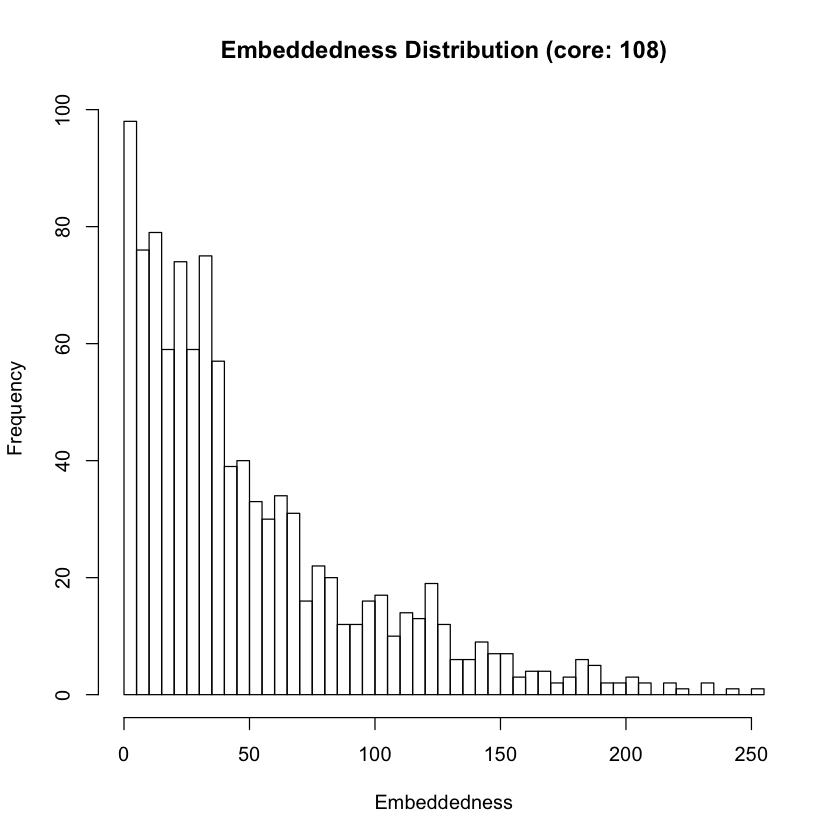

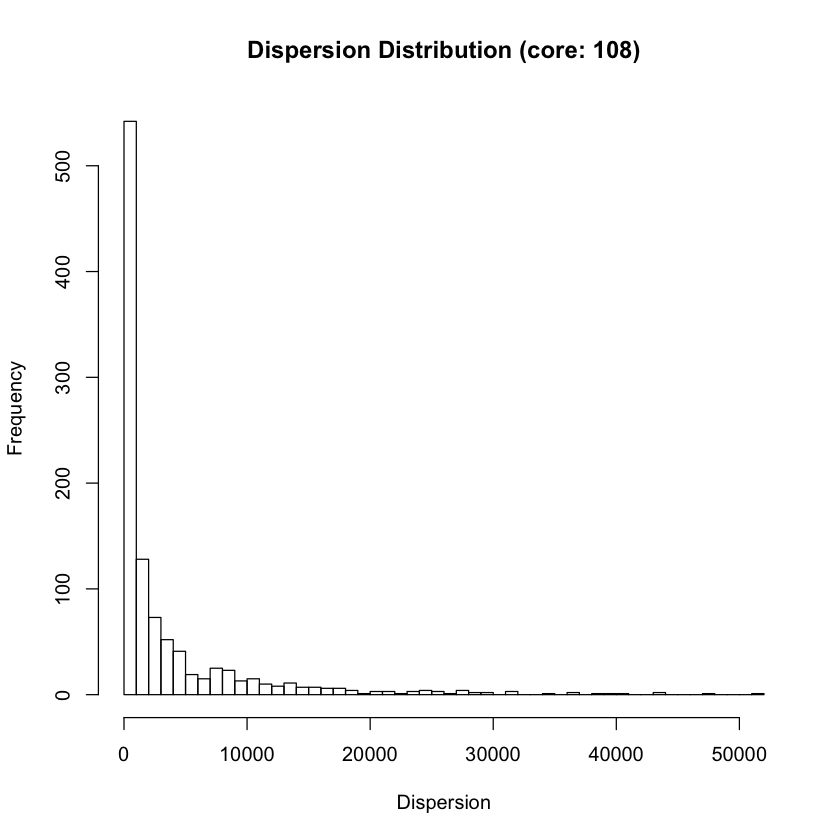

In [186]:
plot_emb_hist(fb_graph, 108)
plot_disp_hist(fb_graph, 108)

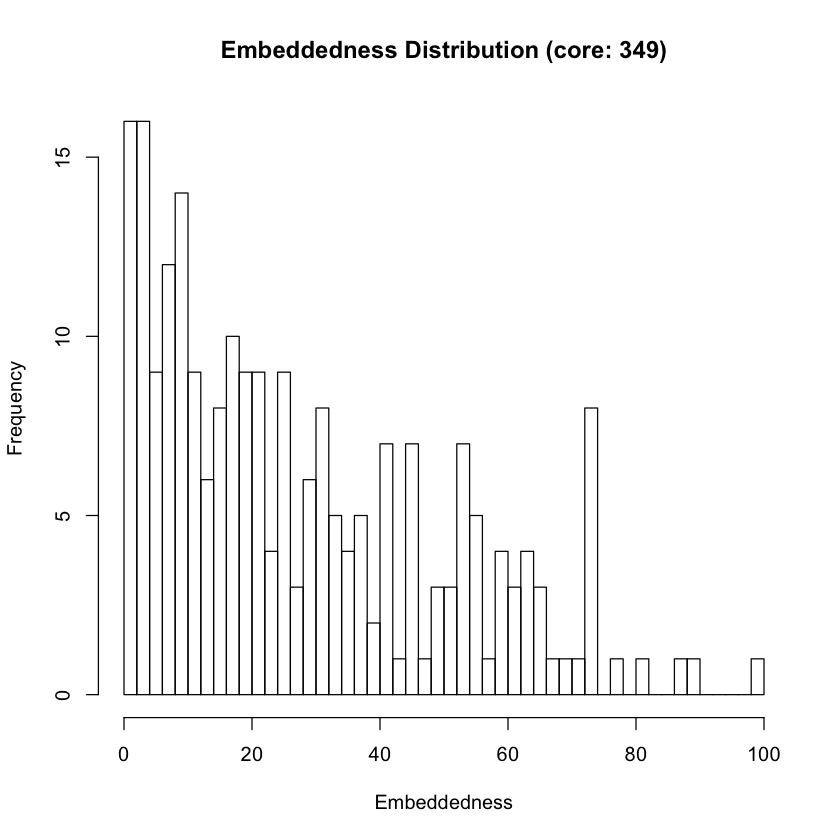

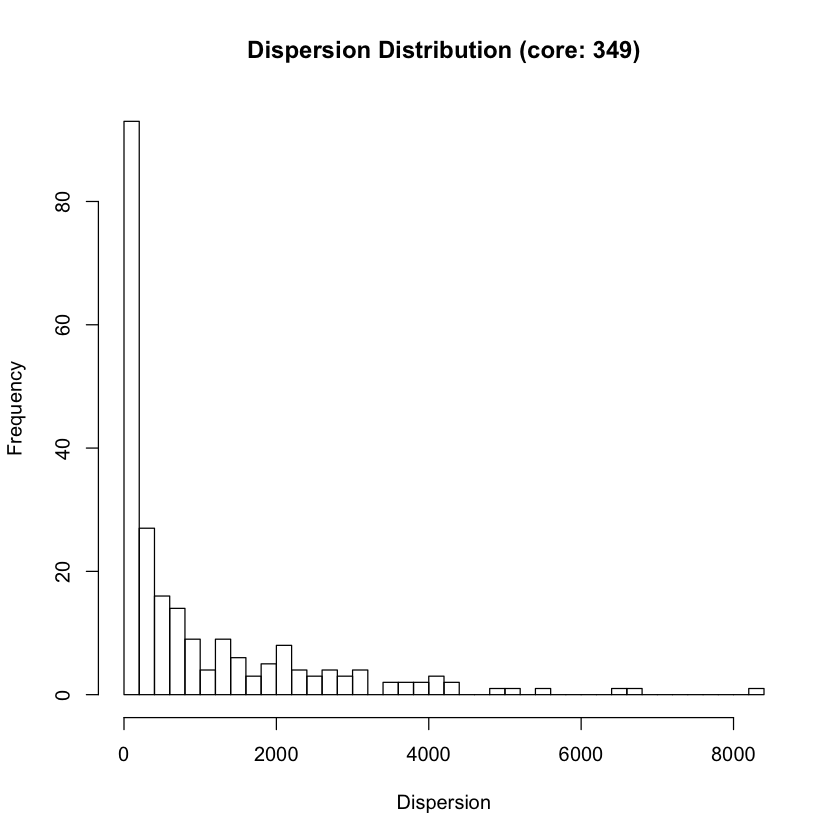

In [187]:
plot_emb_hist(fb_graph, 349)
plot_disp_hist(fb_graph, 349)

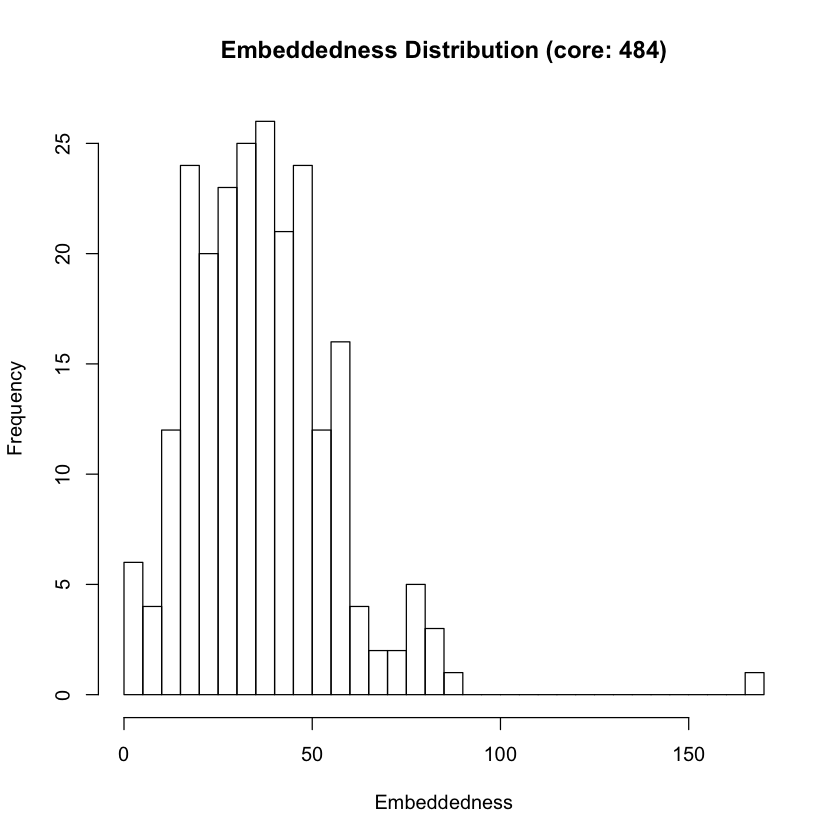

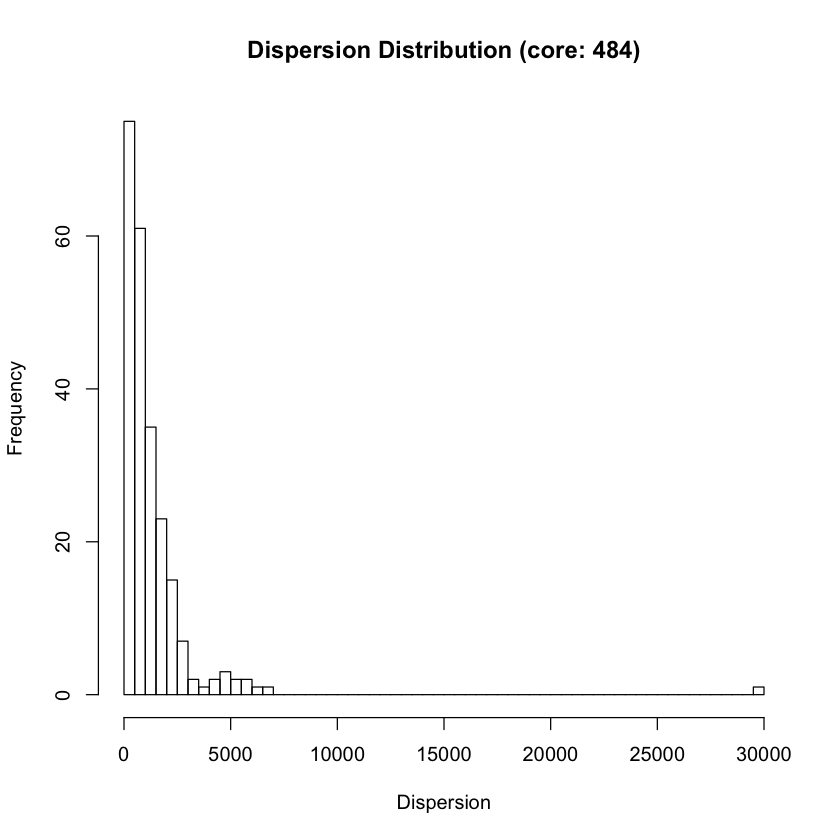

In [188]:
plot_emb_hist(fb_graph, 484)
plot_disp_hist(fb_graph, 484)

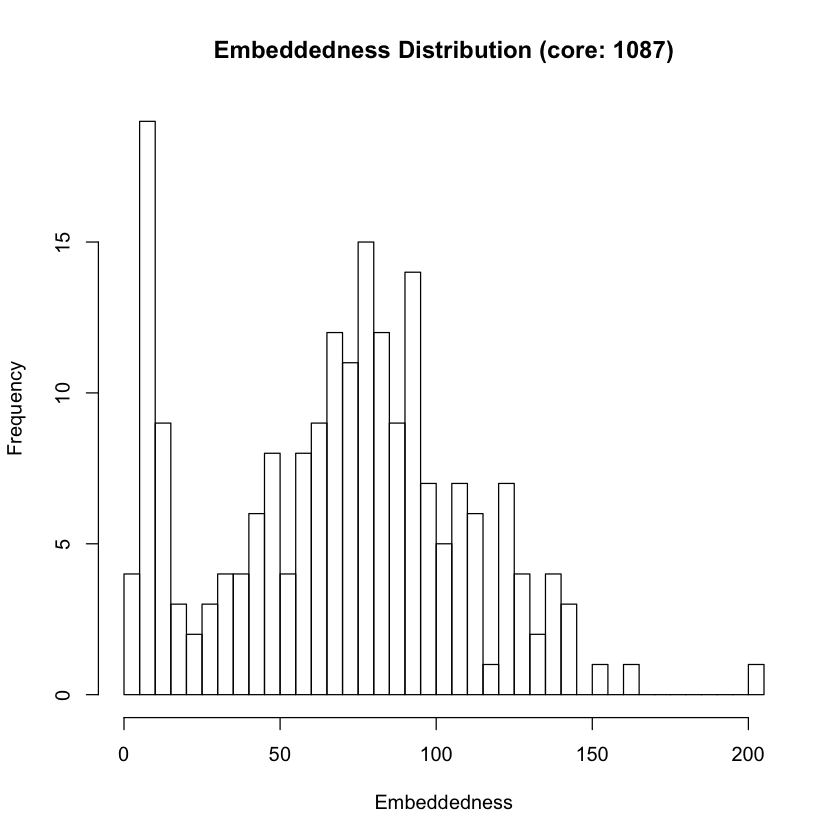

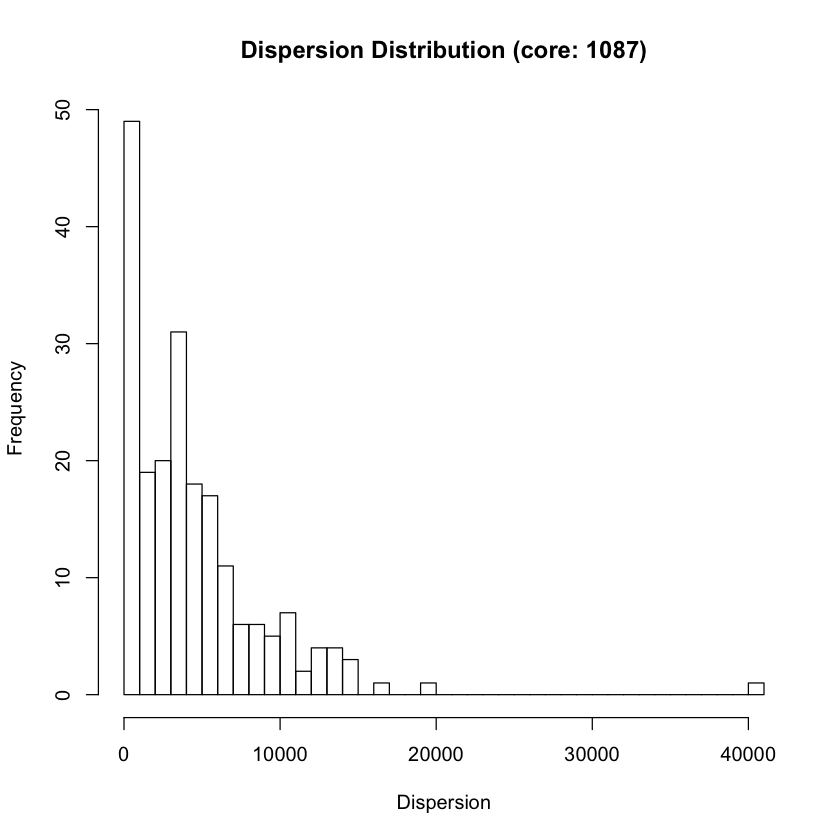

In [189]:
plot_emb_hist(fb_graph, 1087)
plot_disp_hist(fb_graph, 1087)

### Question 13

In [190]:
graph = read.graph("facebook_combined.txt", format="edgelist", directed=FALSE)
V(graph)$name = V(graph)

sub_graph_1 = induced.subgraph(graph, c(1, neighbors(graph, 1)))
    
dispersion_1 = numeric(0)
embeddedness_1 = numeric(0)
node_1 = numeric(0)

all_neigbour = neighbors(sub_graph_1, which(V(sub_graph_1)$name == 1))$name

for(i in 1 : length(all_neigbour)) { 
    curr_core = which(V(sub_graph_1)$name == 1)
    curr_node = which(V(sub_graph_1)$name == all_neigbour[i])
    
    curr_disp = cal_dispersion(sub_graph_1, curr_core, curr_node)
    curr_embd = cal_embeddedness(sub_graph_1, curr_node)
    
    node_1 = c(node_1, curr_node)
    embeddedness_1 = c(embeddedness_1, curr_embd)
    dispersion_1 = c(dispersion_1, curr_disp)
}

In [191]:
graph = read.graph("facebook_combined.txt", format="edgelist", directed=FALSE)
V(graph)$name = V(graph)

sub_graph_108 = induced.subgraph(graph, c(108, neighbors(graph, 108)))
    
dispersion_108 = numeric(0)
embeddedness_108 = numeric(0)
node_108 = numeric(0)

all_neigbour = neighbors(sub_graph_108, which(V(sub_graph_108)$name == 108))$name

for(i in 1 : length(all_neigbour)) { 
    curr_core = which(V(sub_graph_108)$name == 108)
    curr_node = which(V(sub_graph_108)$name == all_neigbour[i])
    
    curr_disp = cal_dispersion(sub_graph_108, curr_core, curr_node)
    curr_embd = cal_embeddedness(sub_graph_108, curr_node)
    
    node_108 = c(node_108, curr_node)
    embeddedness_108 = c(embeddedness_108, curr_embd)
    dispersion_108 = c(dispersion_108, curr_disp)
}

In [192]:
graph = read.graph("facebook_combined.txt", format="edgelist", directed=FALSE)
V(graph)$name = V(graph)

sub_graph_349 = induced.subgraph(graph, c(349, neighbors(graph, 349)))
    
dispersion_349 = numeric(0)
embeddedness_349 = numeric(0)
node_349 = numeric(0)

all_neigbour = neighbors(sub_graph_349, which(V(sub_graph_349)$name == 349))$name

for(i in 1: length(all_neigbour)) { 
    curr_core = which(V(sub_graph_349)$name == 349)
    curr_node = which(V(sub_graph_349)$name == all_neigbour[i])
    
    curr_disp = cal_dispersion(sub_graph_349, curr_core, curr_node)
    curr_embd = cal_embeddedness(sub_graph_349, curr_node)
    
    node_349 = c(node_349, curr_node)
    embeddedness_349 = c(embeddedness_349, curr_embd)
    dispersion_349 = c(dispersion_349, curr_disp)
}

In [193]:
graph = read.graph("facebook_combined.txt", format="edgelist", directed=FALSE)
V(graph)$name = V(graph)

sub_graph_484 = induced.subgraph(graph, c(484, neighbors(graph, 484)))
    
dispersion_484 = numeric(0)
embeddedness_484 = numeric(0)
node_484 = numeric(0)

all_neigbour = neighbors(sub_graph_484, which(V(sub_graph_484)$name == 484))$name

for(i in 1: length(all_neigbour)) { 
    curr_core = which(V(sub_graph_484)$name == 484)
    curr_node = which(V(sub_graph_484)$name == all_neigbour[i])
    
    curr_disp = cal_dispersion(sub_graph_484, curr_core, curr_node)
    curr_embd = cal_embeddedness(sub_graph_484, curr_node)
    
    node_484 = c(node_484, curr_node)
    embeddedness_484 = c(embeddedness_484, curr_embd)
    dispersion_484 = c(dispersion_484, curr_disp)
}

In [194]:
graph = read.graph("facebook_combined.txt", format="edgelist", directed=FALSE)
V(graph)$name = V(graph)

sub_graph_1087 = induced.subgraph(graph, c(1087, neighbors(graph, 1087)))
    
dispersion_1087 = numeric(0)
embeddedness_1087 = numeric(0)
node_1087 = numeric(0)

all_neigbour = neighbors(sub_graph_1087, which(V(sub_graph_1087)$name == 1087))$name

for(i in 1: length(all_neigbour)) { 
    curr_core = which(V(sub_graph_1087)$name == 1087)
    curr_node = which(V(sub_graph_1087)$name == all_neigbour[i])
    
    curr_disp = cal_dispersion(sub_graph_1087, curr_core, curr_node)
    curr_embd = cal_embeddedness(sub_graph_1087, curr_node)
    
    node_1087 = c(node_1087, curr_node)
    embeddedness_1087 = c(embeddedness_1087, curr_embd)
    dispersion_1087 = c(dispersion_1087, curr_disp)
}

In [195]:
plot_max_disp = function(graph, id, community, core){
    nodes_colors = community$membership + 1
    nodes_colors[id] = "red"
    nodes_colors[which(V(graph)$name == core)] = "green"
    
    E(graph)$color = 'gray'
    E(graph)$width = 0.3
    
    E(graph)[inc(id)]$color = 'blue'
    E(graph)[inc(id)]$width = 2
    
    V(graph)$size = 2
    V(graph)[id]$size = 4
    V(graph)[which(V(graph)$name == core)]$size = 4
    plot(graph, 
         vertex.color=nodes_colors, 
         vertex.label=NA,
         main = sprintf("Community Structure with max_dispersion (RED) \n (Core node (GREEN): %s)", core))

}

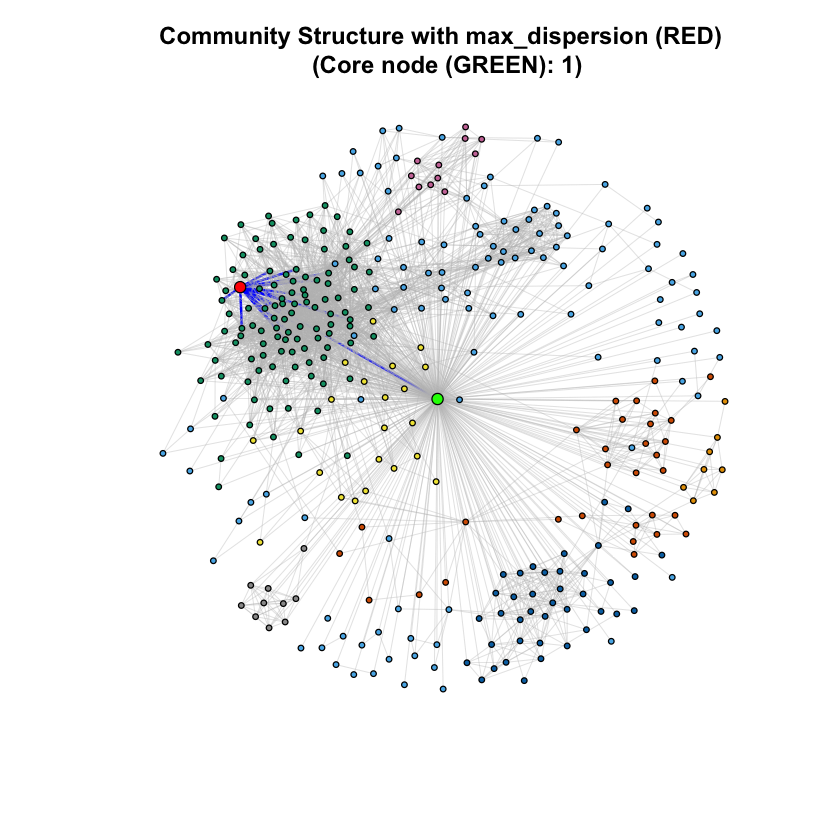

In [196]:
community_g1 = fastgreedy.community(sub_graph_1)
max_dispersion = which.max(dispersion_1)
plot_max_disp(sub_graph_1, max_dispersion, community_g1, 1)

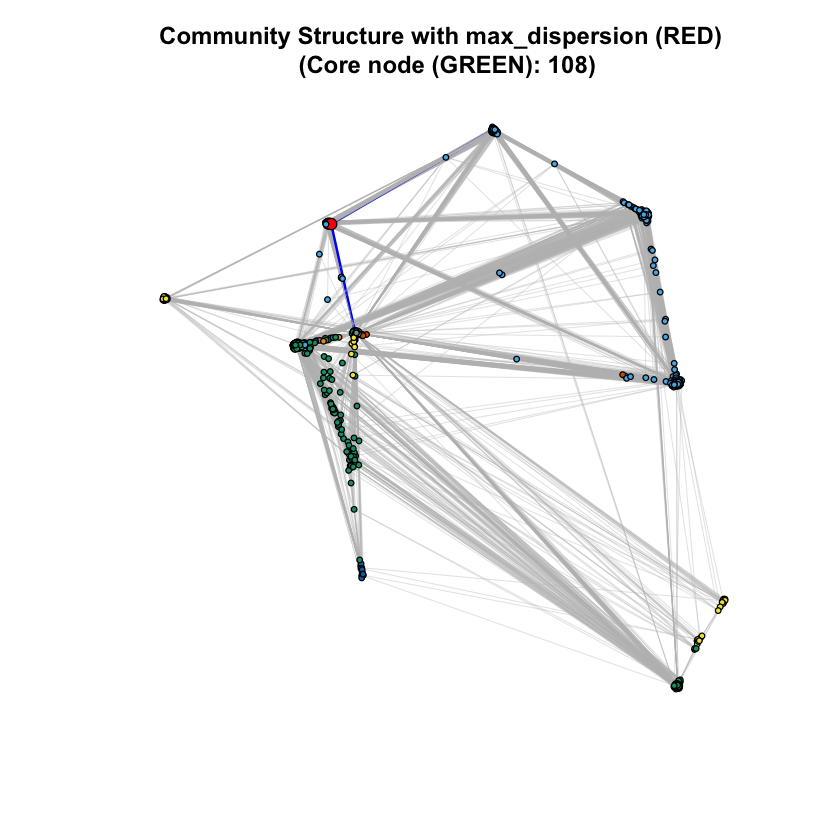

In [197]:
community_g108 = fastgreedy.community(sub_graph_108)
max_dispersion = which.max(dispersion_108)
plot_max_disp(sub_graph_108, max_dispersion, community_g108, 108)

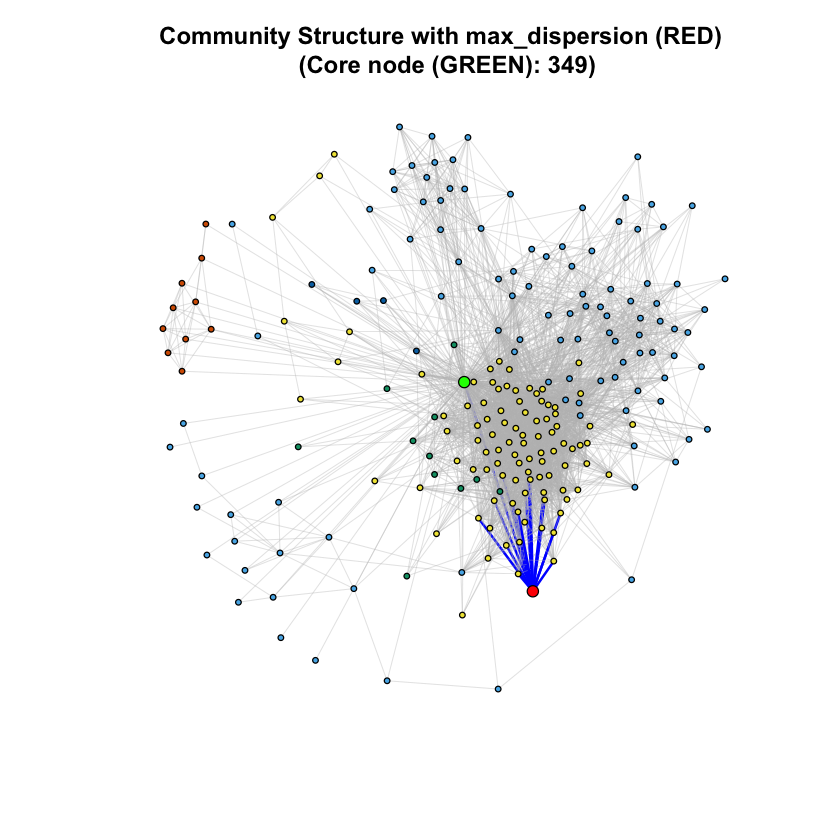

In [198]:
community_g349 = fastgreedy.community(sub_graph_349)
max_dispersion = which.max(dispersion_349)
plot_max_disp(sub_graph_349, max_dispersion, community_g349, 349)

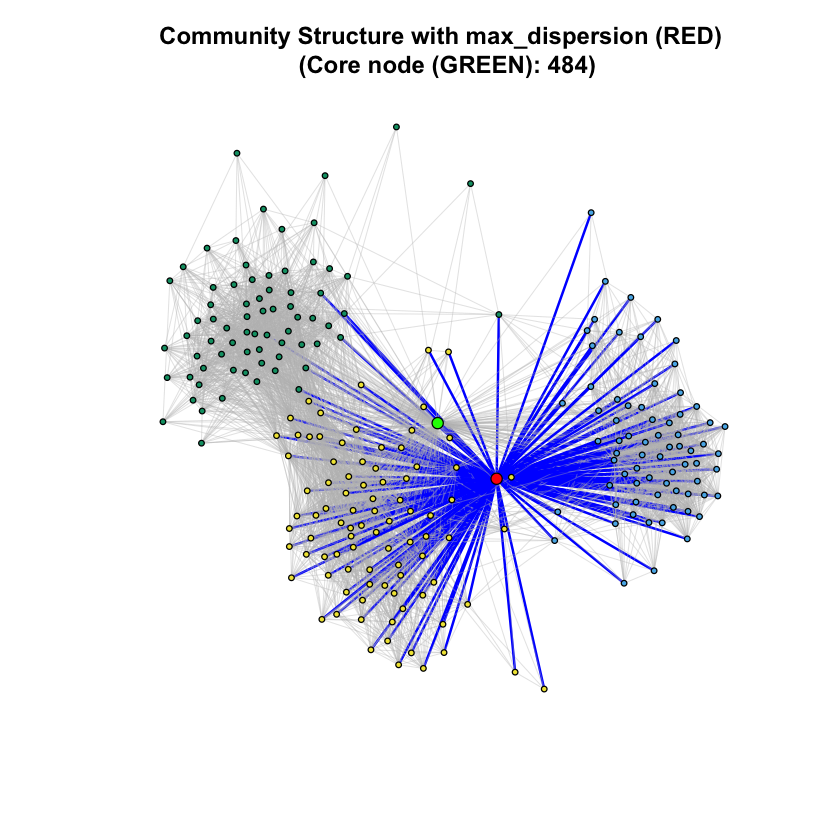

In [199]:
community_g484 = fastgreedy.community(sub_graph_484)
max_dispersion = which.max(dispersion_484)
plot_max_disp(sub_graph_484, max_dispersion, community_g484, 484)

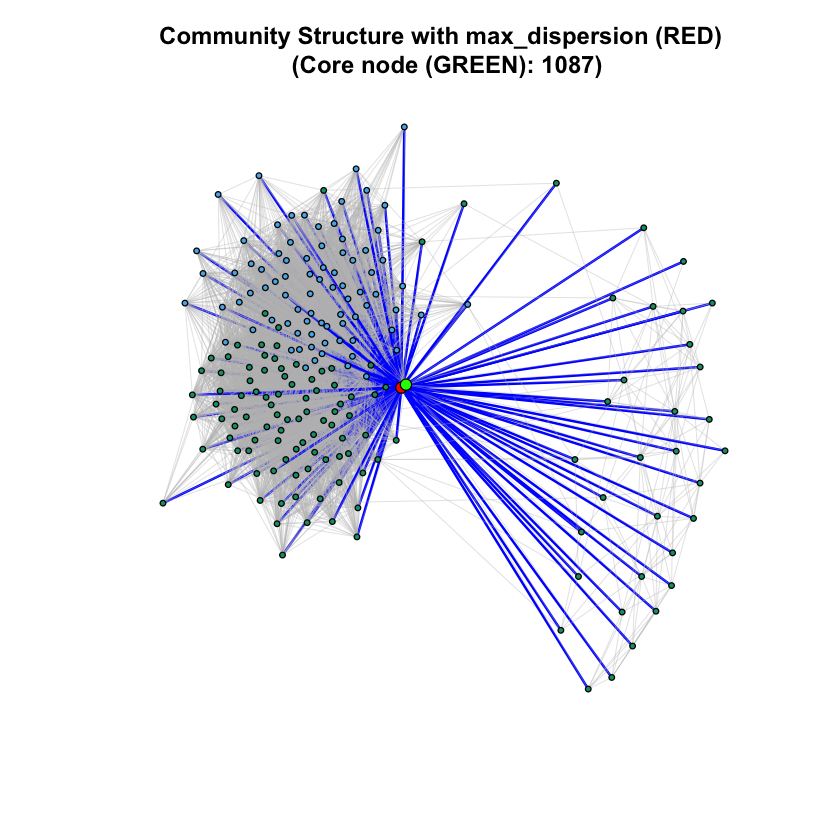

In [200]:
community_g1087 = fastgreedy.community(sub_graph_1087)
max_dispersion = which.max(dispersion_1087)
plot_max_disp(sub_graph_1087, max_dispersion, community_g1087, 1087)

### Question 14

Repeat Question 13, but now highlight the node with maximum embeddedness and the node with maximum $\frac{dispersion}{embeddedness}$. Also, highlight the edges incident to these nodes

In [201]:
plot_max_embd = function(graph, id, community, core){
    nodes_colors = community$membership + 1
    nodes_colors[id] = "red"
    nodes_colors[which(V(graph)$name == core)] = "green"
    
    E(graph)$color = 'gray'
    E(graph)$width = 0.3
    
    E(graph)[inc(id)]$color = 'blue'
    E(graph)[inc(id)]$width = 2
    
    V(graph)$size = 2
    V(graph)[id]$size = 4
    V(graph)[which(V(graph)$name == core)]$size = 4
    plot(graph, 
         vertex.color=nodes_colors, 
         vertex.label=NA,
         main = sprintf("Community Structure with max_embeddedness (RED) \n (Core node (GREEN): %s)", core))

}

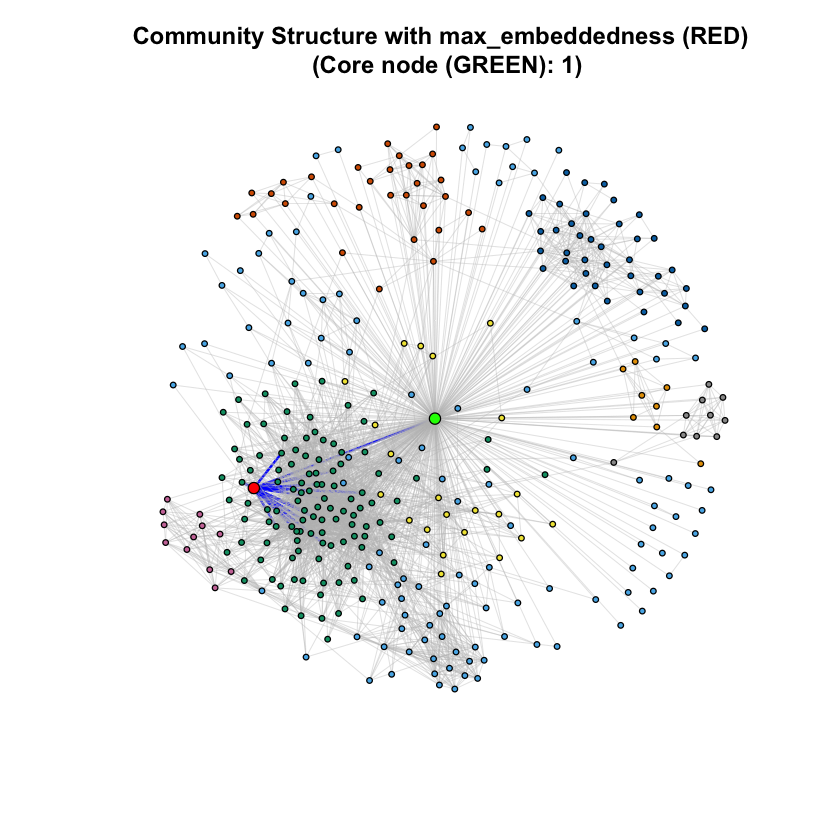

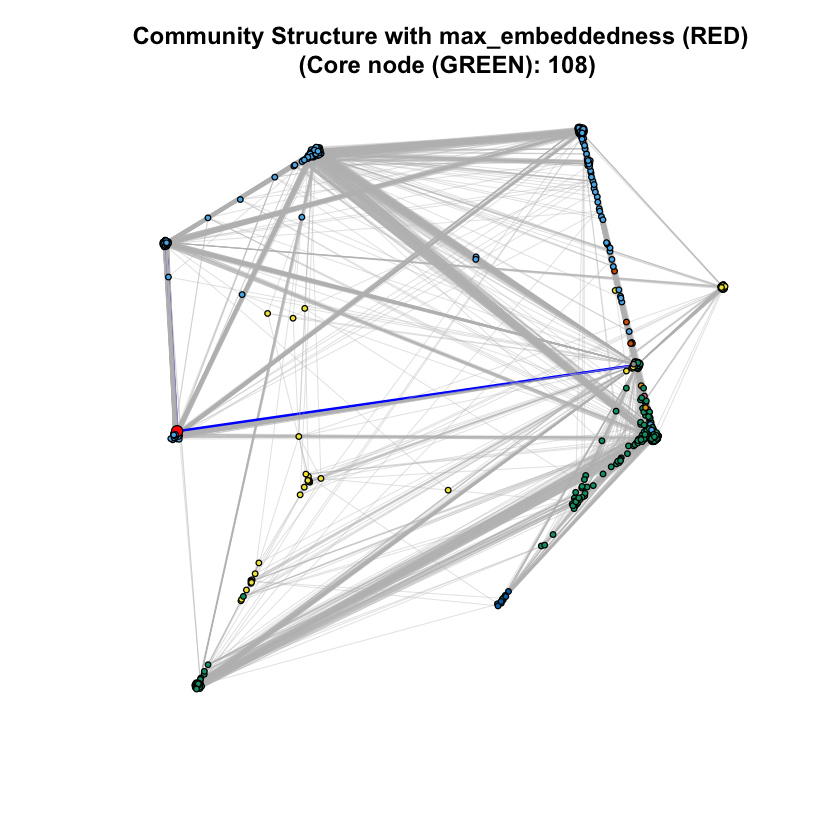

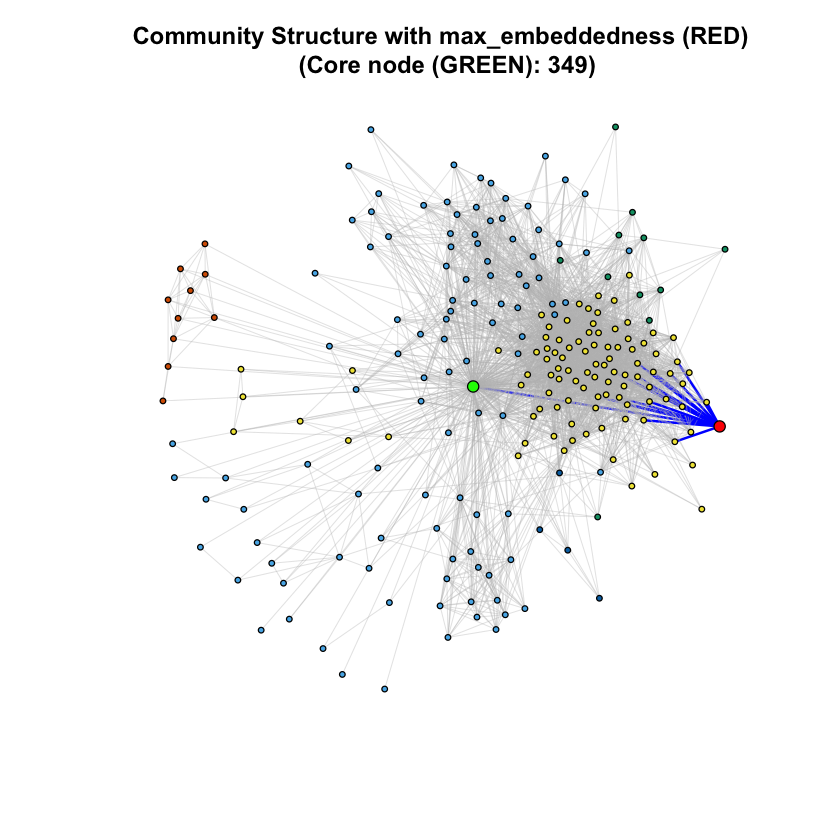

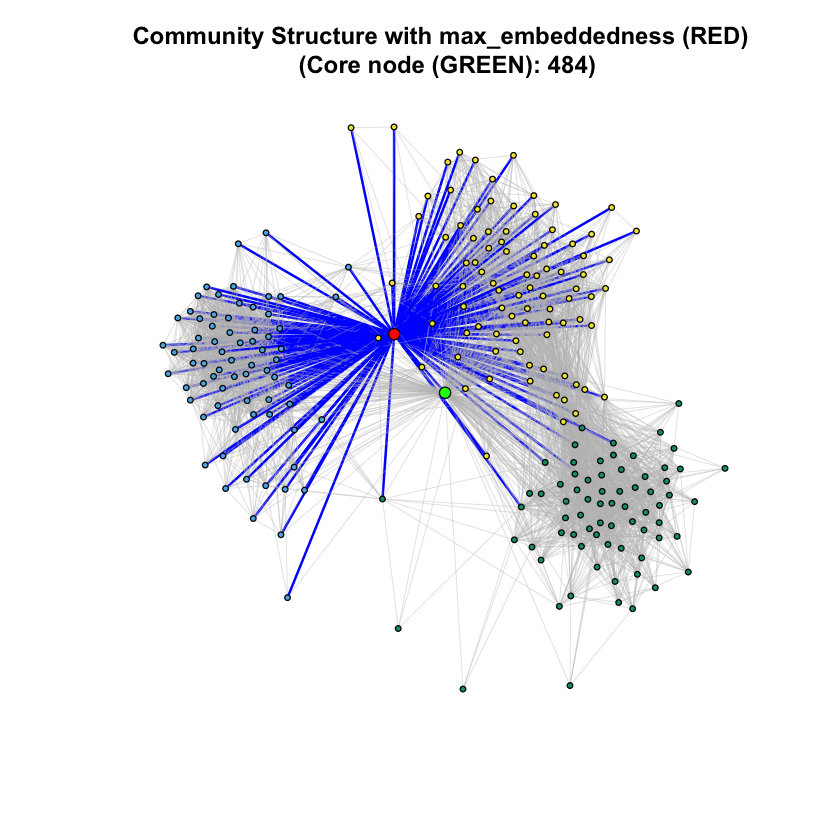

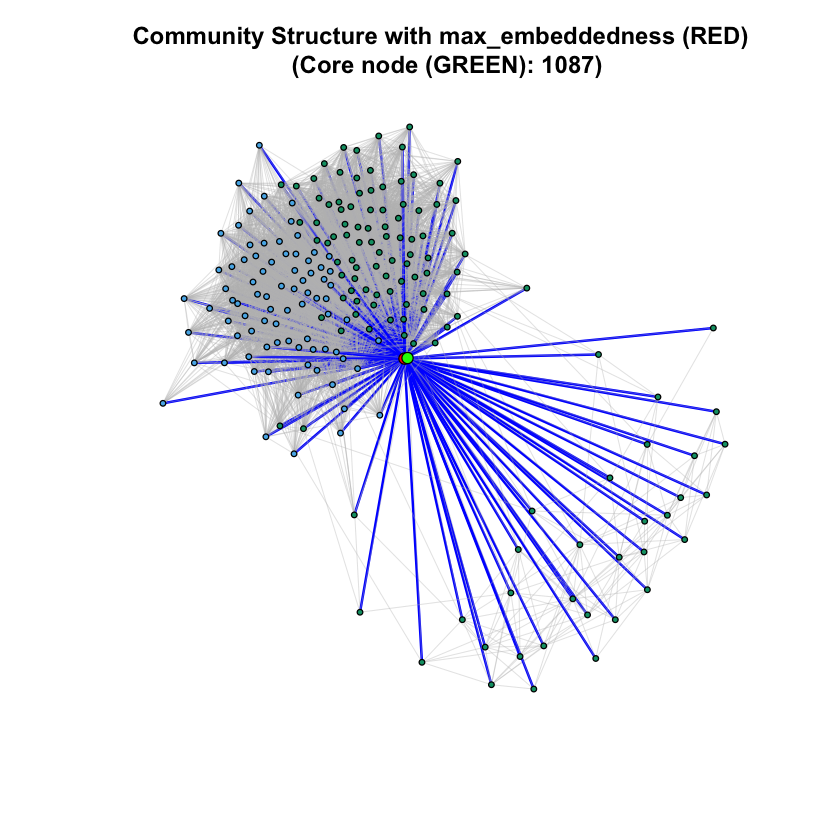

In [202]:
community_g1 = fastgreedy.community(sub_graph_1)
max_embeddedness = which.max(embeddedness_1)
plot_max_embd(sub_graph_1, max_embeddedness, community_g1, 1)

community_g108 = fastgreedy.community(sub_graph_108)
max_embeddedness = which.max(embeddedness_108)
plot_max_embd(sub_graph_108, max_embeddedness, community_g108, 108)

community_g349 = fastgreedy.community(sub_graph_349)
max_embeddedness = which.max(embeddedness_349)
plot_max_embd(sub_graph_349, max_embeddedness, community_g349, 349)

community_g484 = fastgreedy.community(sub_graph_484)
max_embeddedness = which.max(embeddedness_484)
plot_max_embd(sub_graph_484, max_embeddedness, community_g484, 484)

community_g1087 = fastgreedy.community(sub_graph_1087)
max_embeddedness = which.max(embeddedness_1087)
plot_max_embd(sub_graph_1087, max_embeddedness, community_g1087, 1087)

In [203]:
plot_max_ratio = function(graph, id, community, core){
    nodes_colors = community$membership + 1
    nodes_colors[id] = "red"
    nodes_colors[which(V(graph)$name == core)] = "green"
    
    E(graph)$color = 'gray'
    E(graph)$width = 0.3
    
    E(graph)[inc(id)]$color = 'blue'
    E(graph)[inc(id)]$width = 2
    
    V(graph)$size = 2
    V(graph)[id]$size = 4
    V(graph)[which(V(graph)$name == core)]$size = 4
    plot(graph, 
         vertex.color=nodes_colors, 
         vertex.label=NA,
         main = sprintf("Community Structure with max \n dispersion/embeddedness ratio (RED) \n (Core node (GREEN): %s)", core))

}

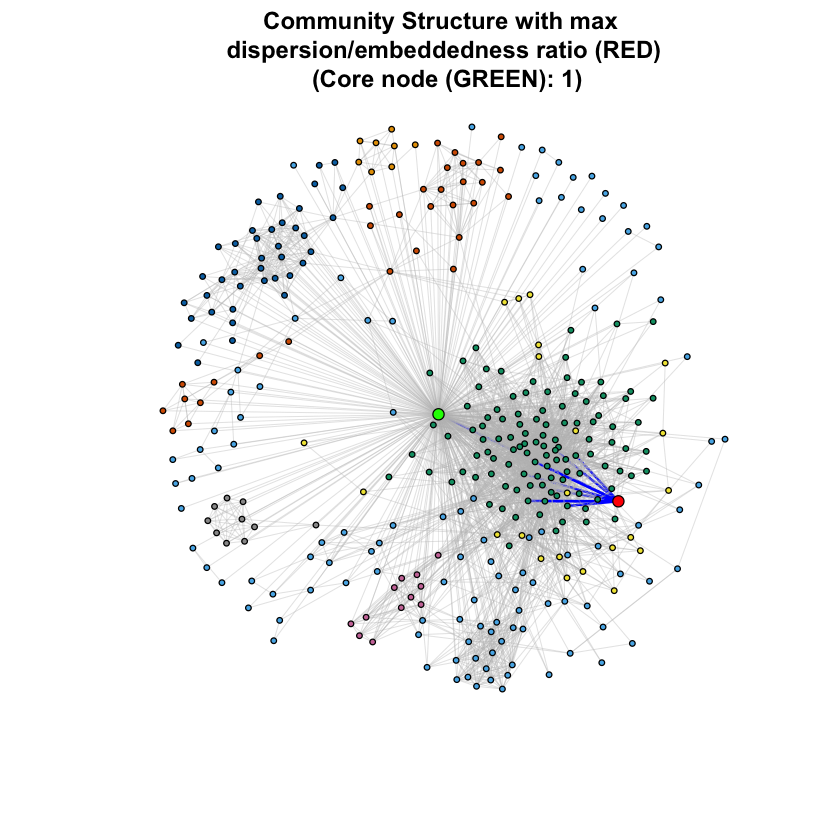

In [204]:
community_g1 = fastgreedy.community(sub_graph_1)
ratio_1 = numeric(0)
for(i in 1 : length(dispersion_1)) {
    ratio = dispersion_1[i] / embeddedness_1[i]
    ratio_1 = c(ratio_1, ratio)
}
max_ratio = which.max(ratio_1)
plot_max_ratio(sub_graph_1, max_ratio, community_g1, 1)

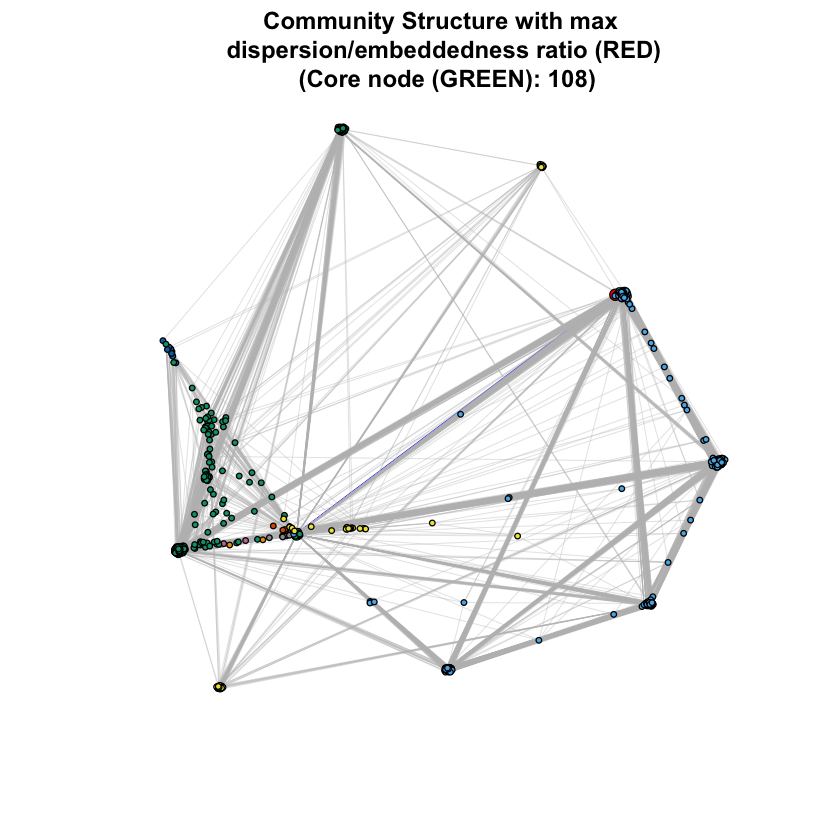

In [205]:
community_g108 = fastgreedy.community(sub_graph_108)
ratio_108 = numeric(0)
for(i in 1 : length(dispersion_108)) {
    ratio = dispersion_108[i] / embeddedness_108[i]
    ratio_108 = c(ratio_108, ratio)
}
max_ratio = which.max(ratio_108)
plot_max_ratio(sub_graph_108, max_ratio, community_g108, 108)

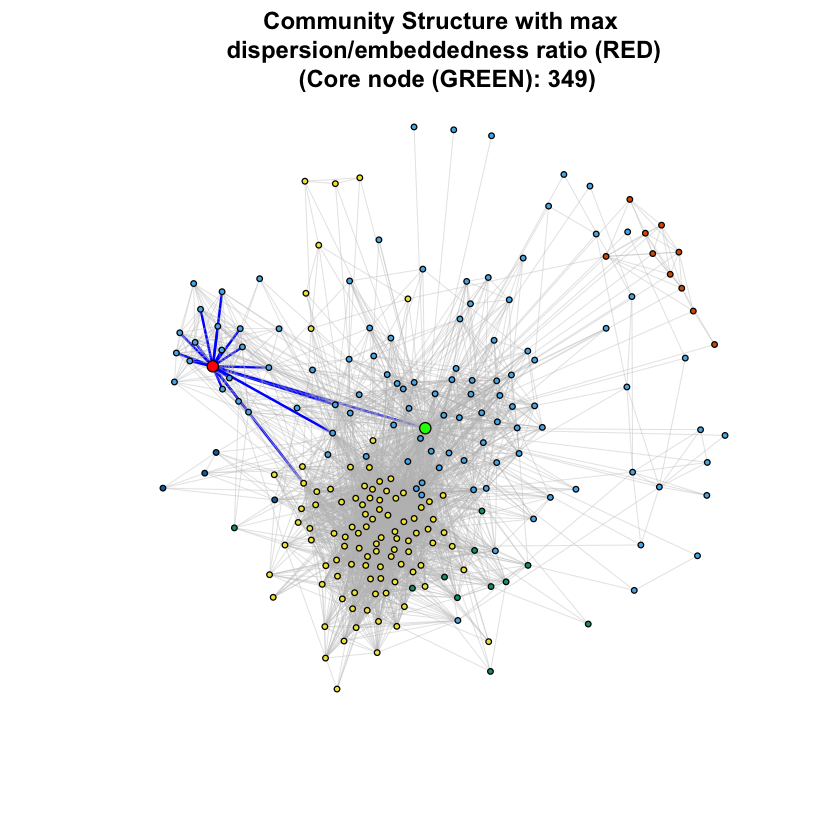

In [206]:
community_g349 = fastgreedy.community(sub_graph_349)
ratio_349 = numeric(0)
for(i in 1 : length(dispersion_349)) {
    ratio = dispersion_349[i] / embeddedness_349[i]
    ratio_349 = c(ratio_349, ratio)
}
max_ratio = which.max(ratio_349)
plot_max_ratio(sub_graph_349, max_ratio, community_g349, 349)

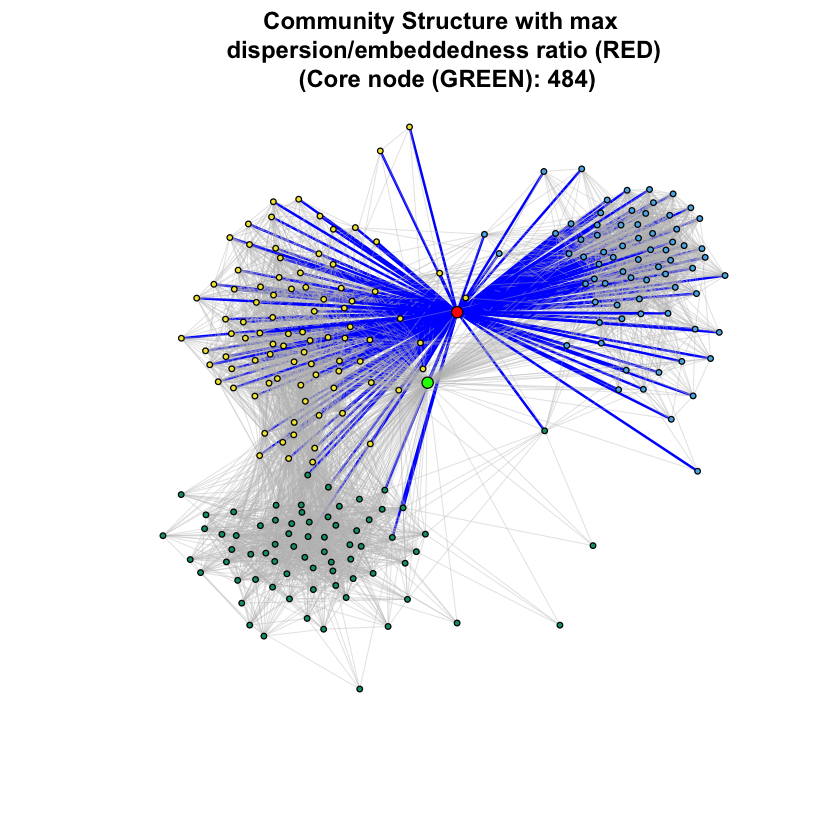

In [207]:
community_g484 = fastgreedy.community(sub_graph_484)
ratio_484 = numeric(0)
for(i in 1 : length(dispersion_484)) {
    ratio = dispersion_484[i] / embeddedness_484[i]
    ratio_484 = c(ratio_484, ratio)
}
max_ratio = which.max(ratio_484)
plot_max_ratio(sub_graph_484, max_ratio, community_g484, 484)

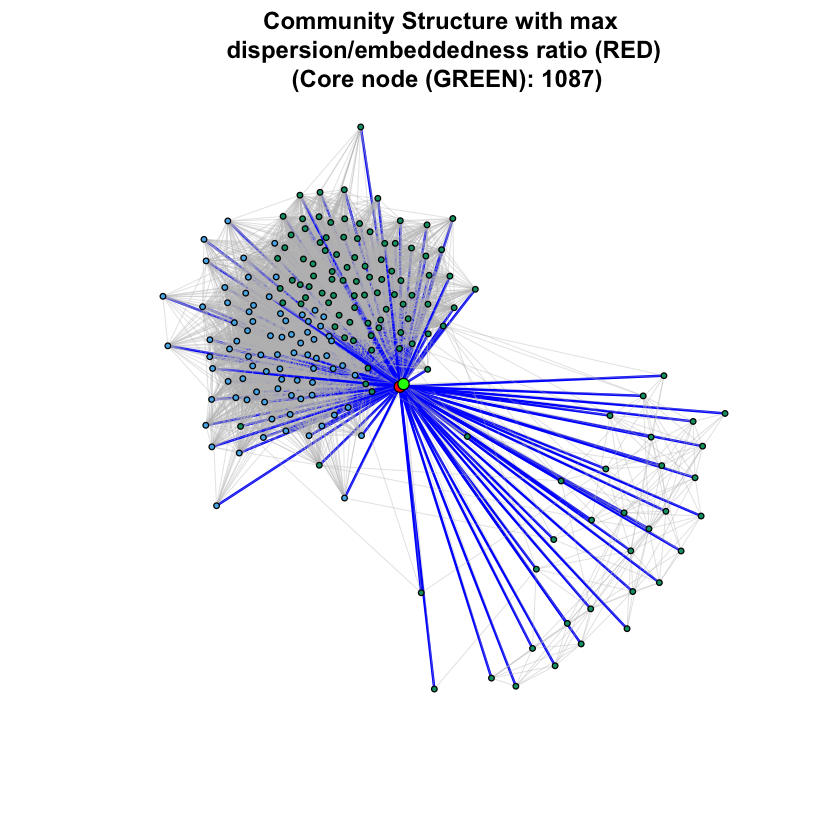

In [208]:
community_g1087 = fastgreedy.community(sub_graph_1087)
ratio_1087 = numeric(0)
for(i in 1 : length(dispersion_1087)) {
    ratio = dispersion_1087[i] / embeddedness_1087[i]
    ratio_1087 = c(ratio_1087, ratio)
}
max_ratio = which.max(ratio_1087)
plot_max_ratio(sub_graph_1087, max_ratio, community_g1087, 1087)

### Question 15

Use the plots from Question 13 and 14 to explain the characteristics of a node revealed by each of this measure

### Question 16

What is |Nr|?

In [209]:
id = 415
network_415 = induced.subgraph(fb_graph, c(id, neighbors(fb_graph,id)))
Nr = which(degree(network_415) == 24)
cat("|Nr| is: ", length(Nr), sep=" ")
cat("\nUser node ID:", Nr, sep=" ")

|Nr| is:  11
User node ID: 31 53 75 90 93 102 118 133 134 136 137

### Question 17

Compute the average accuracy of the friend recommendation algorithm that uses: 
Common Neighbors measure, 
Jaccard measure, 
Adamic Adar measure
Based on the average accuracy values, which friend recommendation algorithm is the best?

In [210]:
CommonNeighbors = function(i, j, graph){
    Si = neighbors(graph,i)
    Sj = neighbors(graph,j)
    intersec = intersection(Si, Sj)
    return(length(intersec))
}

Jaccard = function(i, j, graph){
  Si = neighbors(graph,i)
  Sj = neighbors(graph,j)
  intersec = intersection(Si, Sj)
  uni = union(Si, Sj)
  if (length(uni) == 0) return(0)
  else return(length(intersec)/length(uni))
}

AdamicAdar = function(i, j, graph){
  Si = neighbors(graph,i)
  Sj = neighbors(graph,j)
  intersec = intersection(Si,Sj)
  sum = 0
  for (k in intersec){
    sum = sum + 1/log(length(neighbors(graph,k)))
  }
  return(sum)
}

#P is recommended friends, and R is listed friends
Recommendation_Acc = function(P, R){
    if (length(R) == 0) return(0)
    else return(length(intersect(P, R))/length(R))
}

In [211]:
#common neighbors measurement
iterNum = 10
totscore = numeric(0)
for(choice in Nr){
  accuracy = numeric(0)
  for(i in 1:iterNum){
    temp_graph = network_415
    friend_listed = neighbors(temp_graph, choice)
    friend_deleted = integer(0) #R in the context
    for(j in friend_listed){
      if(sample(1:4,1) == 1){
        edge_deleted = sprintf("%s|%s",choice,j)
        temp_graph = temp_graph - edge(edge_deleted)
        friend_deleted = c(friend_deleted, j)
      }
    }
    friend_aft_del = neighbors(temp_graph, choice)
    test_1 = setdiff(V(temp_graph), friend_aft_del)
    test_2 = setdiff(test_1,c(choice))
    result = numeric(0)
    for(k in test_2){
      result = c(result, CommonNeighbors(k, choice, temp_graph))
    }
    order_dec = order(result,decreasing = TRUE)
    order_ind = test_2[order_dec]
    friend_recommend = numeric(0)
    friend_recommend = order_ind[1:length(friend_deleted)] #P in the context
    accuracy = c(accuracy, Recommendation_Acc(friend_recommend, friend_deleted))
  }
  totscore = c(totscore, mean(accuracy))

}
cat("the average accuracy of the common neighbor method is:", mean(totscore), sep=" ")


the average accuracy of the common neighbor method is: 0.8231205

In [212]:
#Jaccard measure
iterNum = 10
totscore = numeric(0)
for(choice in Nr){
  accuracy = numeric(0)
  for(i in 1:iterNum){
    temp_graph = network_415
    friend_listed = neighbors(temp_graph, choice)
    friend_deleted = integer(0)
    for(j in friend_listed){
      if(sample(1:4,1) == 1){
        edge_deleted = sprintf("%s|%s",choice,j)
        temp_graph = temp_graph - edge(edge_deleted)
        friend_deleted = c(friend_deleted, j)
      }
    }
    friend_aft_del = neighbors(temp_graph, choice)
    test_1 = setdiff(V(temp_graph), friend_aft_del)
    test_2 = setdiff(test_1,c(choice))
    result = numeric(0)
    for(k in test_2){
      result = c(result, Jaccard(k, choice, temp_graph))
    }
    order_dec = order(result,decreasing = TRUE)
    order_ind = test_2[order_dec]
    friend_recommend = numeric(0)
    friend_recommend = order_ind[1:length(friend_deleted)]
    accuracy = c(accuracy, Recommendation_Acc(friend_recommend, friend_deleted))
  }
  totscore = c(totscore, mean(accuracy))
}
cat("the average accuracy of the Jaccard method is:", mean(totscore), sep=" ")


the average accuracy of the Jaccard method is: 0.7859078

In [213]:
#Adamic Adar measure
iterNum = 10
totscore = numeric(0)
for(choice in Nr){
  accuracy = numeric(0)
  for(i in 1:iterNum){
    temp_graph = network_415
    friend_listed = neighbors(temp_graph, choice)
    friend_deleted = integer(0)
    for(j in friend_listed){
      if(sample(1:4,1) == 1){
        edge_deleted = sprintf("%s|%s",choice,j)
        temp_graph = temp_graph - edge(edge_deleted)
        friend_deleted = c(friend_deleted, j)
      }
    }
    friend_aft_del = neighbors(temp_graph, choice)
    test_1 = setdiff(V(temp_graph), friend_aft_del)
    test_2 = setdiff(test_1,c(choice))
    result = numeric(0)
    for(k in test_2){
      result = c(result, AdamicAdar(k, choice, temp_graph))
    }
    order_dec = order(result,decreasing = TRUE)
    order_ind = test_2[order_dec]
    friend_recommend = numeric(0)
    friend_recommend = order_ind[1:length(friend_deleted)]
    accuracy = c(accuracy, Recommendation_Acc(friend_recommend, friend_deleted))
  }
  totscore = c(totscore, mean(accuracy))
}
cat("the average accuracy of the Adamic Adar method is:", mean(totscore), sep=" ")


the average accuracy of the Adamic Adar method is: 0.8044622

# 2. Google+ network

In this part, we will explore the structure of the Google+ network. The dataset for creating the network can be found in the link below:

http://snap.stanford.edu/data/egonets-Gplus.html

Create directed personal networks for users who have more than 2 circles. The data required to create such personal networks can be found in the ﬁle named gplus.tar.gz.

### Question 18

How many personal networks are there?

In [214]:
if (!require("igraph")) install.packages("igraph")
library ("igraph")

In [215]:
nets = dir("gplus",pattern = "circles")
network_count = 0
for(i in 1 : length(nets)) {
    file = paste("gplus/", nets[i], sep="")
    file_buffer = file(file, open="r")
    circles = readLines(file_buffer)
    close(file_buffer)
    if(length(circles) > 2) {
        network_count = network_count + 1
    }
}
print(sprintf("There are %i that have more than 2 circles", network_count))

[1] "There are 57 that have more than 2 circles"


### Question 19

For the 3 personal networks (node ID given below), plot the in-degree and outdegree distribution of these personal networks. Do the personal networks have a similar in and out degree distribution? In this question, you should have 6 plots.

* 109327480479767108490
* 115625564993990145546
* 101373961279443806744

In [216]:
plot_in_out_deg_distribution = function(nodeId){
    edge_file = paste("gplus/", nodeId, ".edges", sep="")
    net = read.graph(edge_file, format="ncol", directed=TRUE)
    
    net = add.vertices(net, nv=1, name=nodeId)
    
    edges = c()
    for (node in 1 : (vcount(net) - 1))
    {
        edges = c(edges, c(vcount(net), node))
    }
    net = add_edges(net, edges)
    
    plot(degree.distribution(net, mode="out"), 
         type="l",
         main=sprintf("Out-Degree Distribution for \nNode %s", nodeId), 
         xlab="Degree",
         ylab="Frequency")
    plot(degree.distribution(net, mode="in"), 
         type="l",
         main=sprintf("In-Degree Distribution for \nNode %s", nodeId), 
         xlab="Degree",
         ylab="Frequency")
}

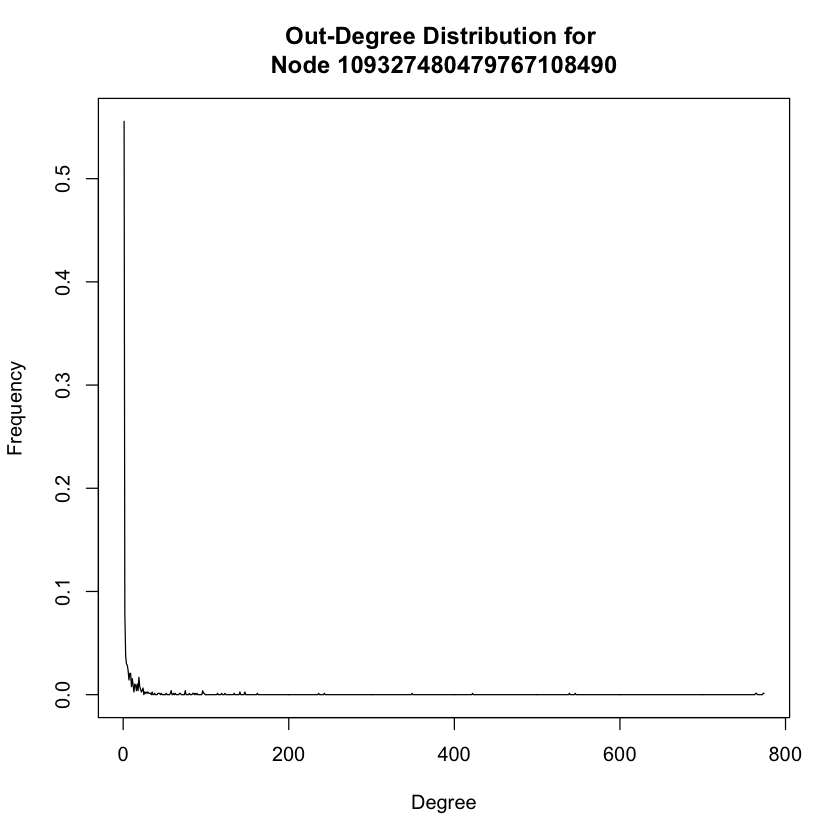

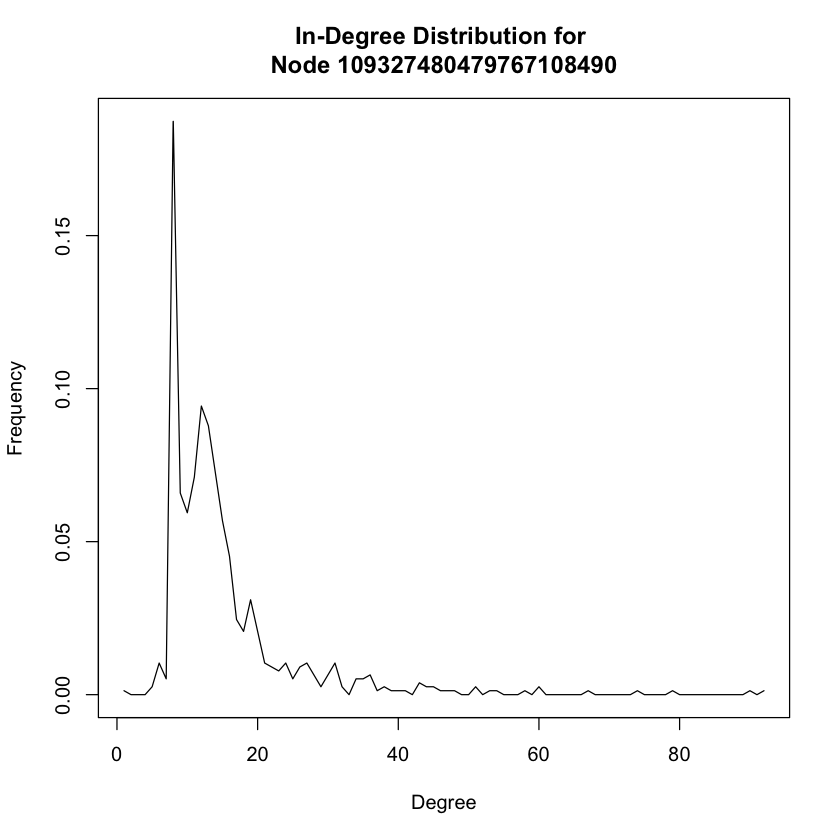

In [217]:
plot_in_out_deg_distribution("109327480479767108490")

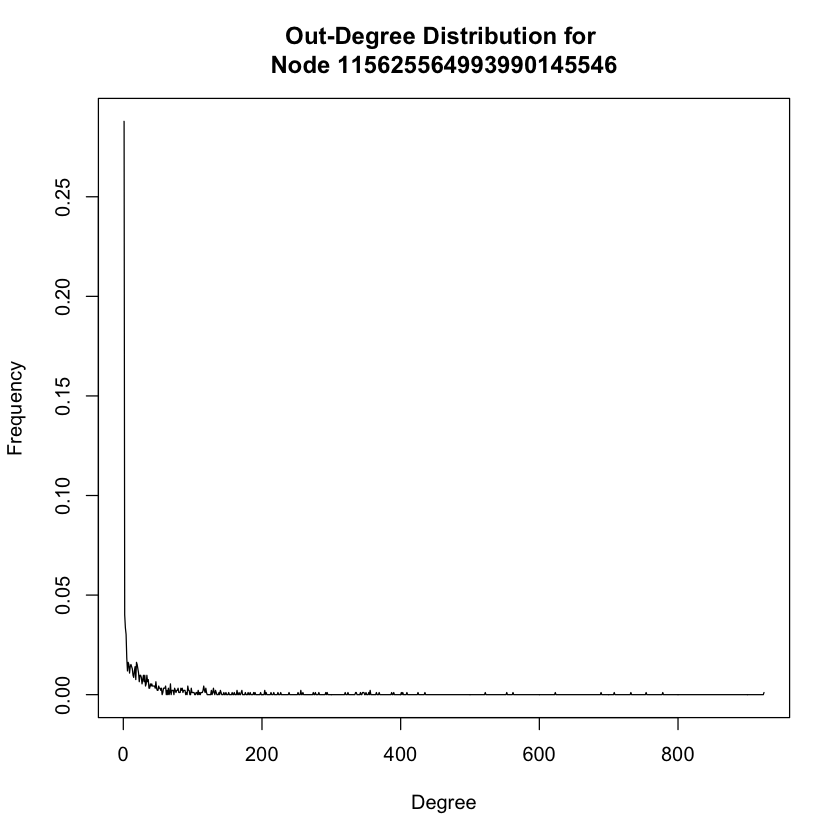

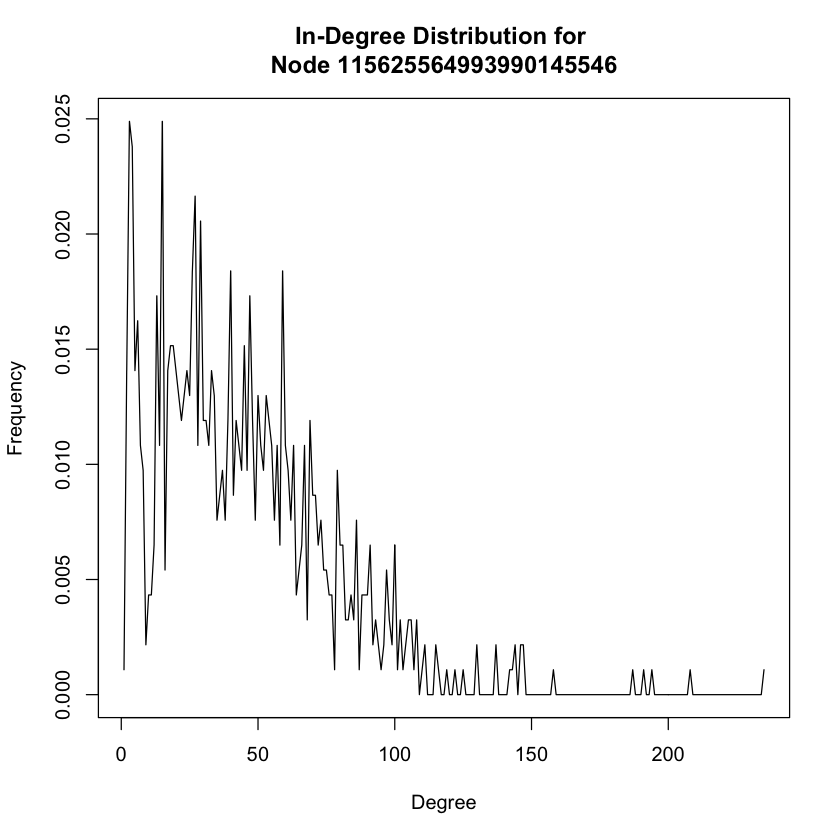

In [218]:
plot_in_out_deg_distribution("115625564993990145546")

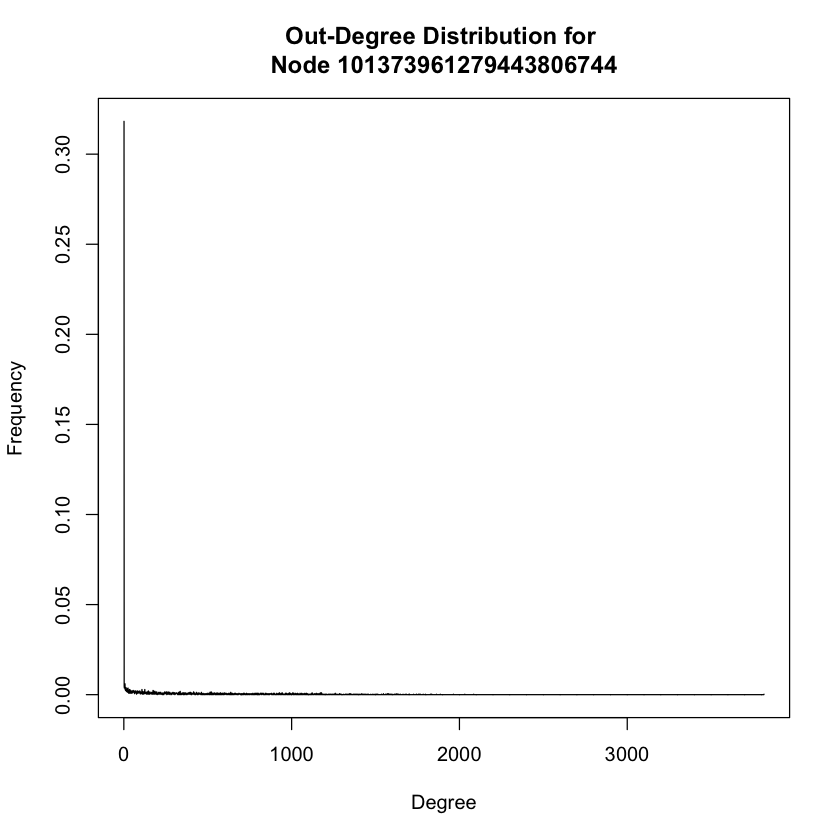

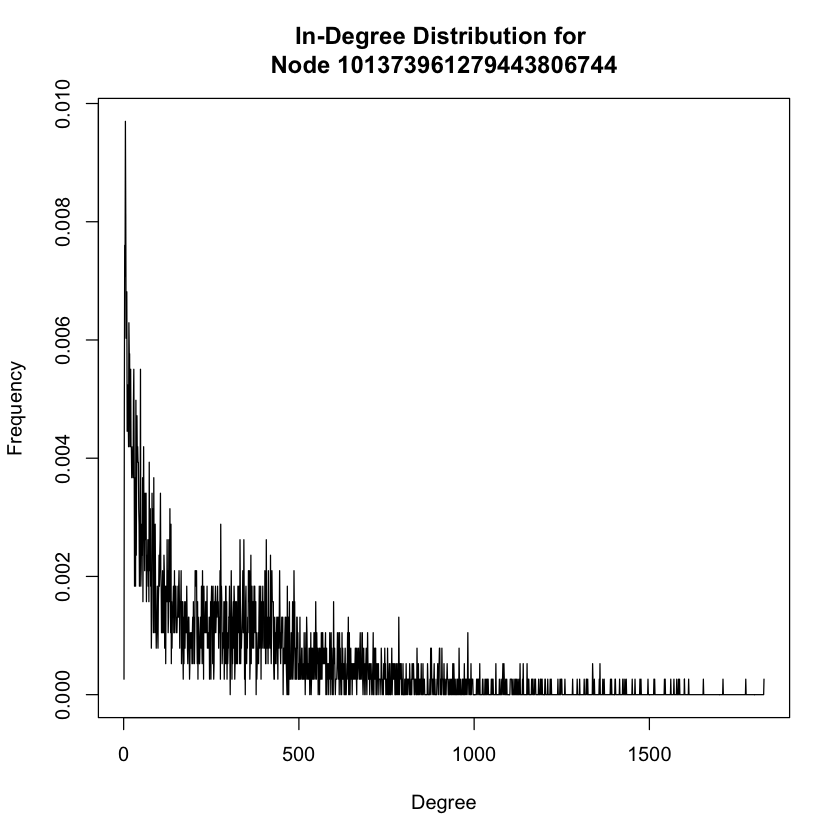

In [219]:
plot_in_out_deg_distribution("101373961279443806744")

### Question 20

For the 3 personal networks picked in Question 19, extract the community structure of each personal network using Walktrap community detection algorithm. Report the modularity scores and plot the communities using colors. Are the modularity scores similar? In this question, you should have 3 plots.

In [220]:
generate_net = function(nodeId) {
    edge_file = paste("gplus/", nodeId, ".edges", sep="")
    net = read.graph(edge_file, format="ncol", directed=TRUE)
    
    net = add.vertices(net, nv=1, name=nodeId)
    
    edges = c()
    for (node in 1 : (vcount(net) - 1))
    {
        edges = c(edges, c(vcount(net), node))
    }
    net = add_edges(net, edges)
    return (net)
}

[1] "The modularity scores for the node 109327480479767108490 is 0.191090"


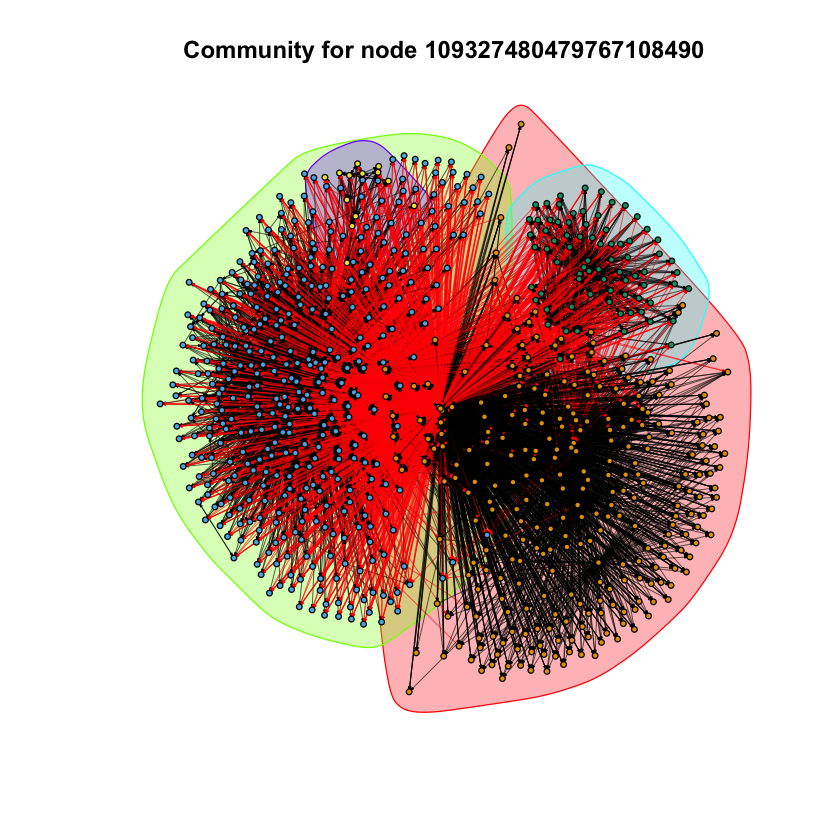

In [221]:
net1 = generate_net("109327480479767108490")
community1 = walktrap.community(net1)
mod_score1 = modularity(community1)

print(sprintf("The modularity scores for the node 109327480479767108490 is %f", mod_score))

plot(community1, 
     net1, 
     vertex.label=NA, 
     vertex.size=2, 
     edge.arrow.size=0.1,
     edge.width=0.5,
     main=sprintf("Community for node 109327480479767108490"))

[1] "The modularity scores for the node 115625564993990145546 is 0.191090"


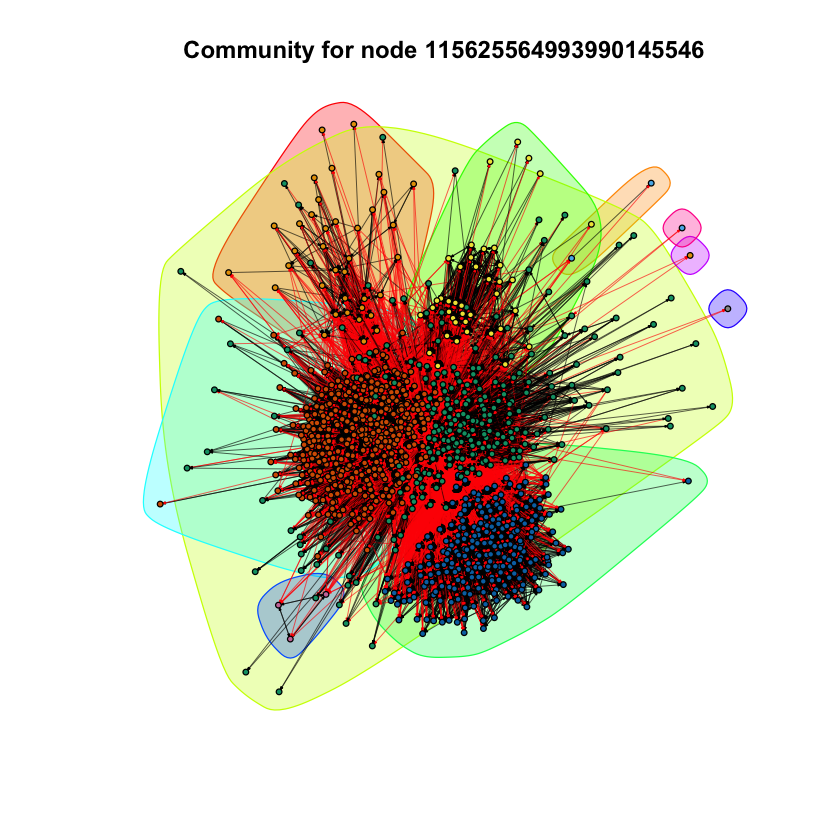

In [222]:
net2 = generate_net("115625564993990145546")
community2 = walktrap.community(net2)
mod_score2 = modularity(community2)

print(sprintf("The modularity scores for the node 115625564993990145546 is %f", mod_score))

plot(community2, 
     net2, 
     vertex.label=NA, 
     vertex.size=2, 
     edge.arrow.size=0.1,
     edge.width=0.5,
     main=sprintf("Community for node 115625564993990145546"))

[1] "The modularity scores for the node 101373961279443806744 is 0.191090"


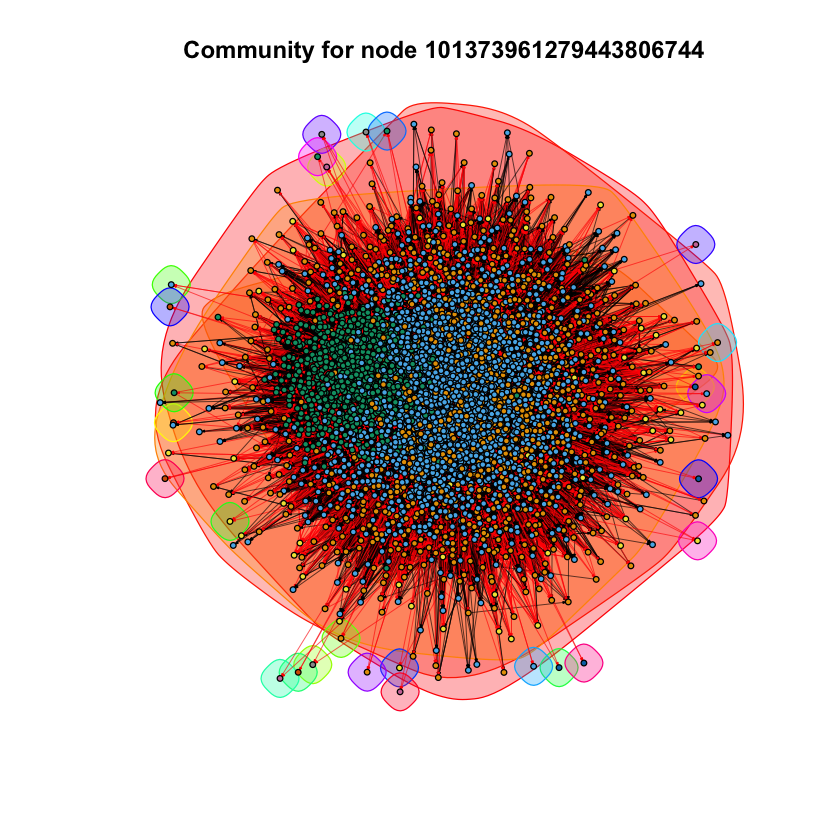

In [223]:
net3 = generate_net("101373961279443806744")
community3 = walktrap.community(net3)
mod_score3 = modularity(community3)

print(sprintf("The modularity scores for the node 101373961279443806744 is %f", mod_score))

plot(community3, 
     net3, 
     vertex.label=NA, 
     vertex.size=2, 
     edge.arrow.size=0.1,
     edge.width=0.5,
     main=sprintf("Community for node 101373961279443806744"))

### Question 21

Based on the expression for h and c, explain the meaning of homogeneity and completeness in words.

### Question 22
Compute the h and c values for the community structures of the 3 personal
network (same nodes as Question 19). Interpret the values and provide a detailed explanation.

In [224]:
get_C = function(nodeId) {
    file = paste("gplus/", nodeId, '.circles', sep="")
    file_buffer = file(file, open="r")
    circles = readLines(file_buffer)
    close(file_buffer)
    C <- c()
    for (cir in circles) {
        content = unlist(strsplit(cir, "\t"))
        people = content[2:length(content)]
        C = c(C, list(people))
    }
    return (C)
}

In [225]:
get_K = function(nodeId) {
    net <- generate_net(nodeId)
    communities <- walktrap.community(net)
    K <- c()
    for (i in 1:length(communities)) {
        K <- c(K, list(communities[[i]]))
    }
    return (K)
}

In [226]:
get_Aji = function(C, K) {
    Aji <- matrix(0, nrow = length(K), ncol = length(C))
    for (j in 1:length(K)) {
        for (person in K[[j]]){
            for (i in 1:length(C)){
                if (person %in% C[[i]]){
                    Aji[j, i] = Aji[j, i]+1
                }
            }
        }
    }
    return (Aji)
}

In [227]:
get_N = function(C){
    N <- 0
    for (idx in 1:length(C)){
        N <- N+length(C[[idx]])
    }
    return (N)
}

In [228]:
get_homogeneity = function(C, K, N, Aji){
    HC <- 0
    HCK <- 0
    for (c_idx in 1:length(C)){
        ai <- length(C[[c_idx]])
        HC <- HC-(ai/N)*log10(ai/N)
        for (k_idx in 1:length(K)){
            if (Aji[k_idx, c_idx] != 0){
                bj <- length(K[[k_idx]])
                HCK <- HCK-(Aji[k_idx, c_idx]/N)*log10(Aji[k_idx, c_idx]/bj)
            }
        }
    }
    h <- 1-HCK/HC
    return (h)
}

In [229]:
get_completeness = function(C, K, N, Aji){
    HKC <- 0
    HK <- 0
    for (j in 1:length(K)){
        bi <- length(K[[j]])
        HK <- HK-(bi/N)*log10(bi/N)
        for (i in 1:length(C)){
            if (Aji[j, i] != 0){ 
                ai <- length(C[[i]])
                HKC <- HKC-(Aji[j, i]/N)*log10(Aji[j, i]/ai)
            }
        }
    }
    c <- 1-HKC/HK
    return (c)
}

In [230]:
get_All = function(nodeId){
    C = get_C(nodeId)
    K = get_K(nodeId)
    Aji = get_Aji(C, K)
    N = get_N(C)
    h = get_homogeneity(C, K, N, Aji)
    c = get_completeness(C, K, N, Aji)

    print('------------------------------------------------------')
    cat("For node", nodeId, "\n")
    cat("Homogeneity:", h, "\n")
    cat("Completeness:", c, "\n")
}

In [231]:
get_All("109327480479767108490")
get_All("115625564993990145546")
get_All("101373961279443806744")

[1] "------------------------------------------------------"
For node 109327480479767108490 
Homogeneity: 0.884913 
Completeness: 0.5088401 
[1] "------------------------------------------------------"
For node 115625564993990145546 
Homogeneity: 0.7970808 
Completeness: -0.1283379 
[1] "------------------------------------------------------"
For node 101373961279443806744 
Homogeneity: -0.679265 
Completeness: -1.259542 
